# OpenCV Salient Points and Local Descriptors to Recognize Landmark Building in Century-old Postcard

**AUTHOR: CAMELIA CIOLAC**  
ciolac_c@inria-alumni.fr

In this mini-project we explore how traditional computer vision approaches can be used in order to find similarities between images. We apply these techniques to find the best match between a century-old postal card and the current photos of several neoclassical buildings from Romanian cities.

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

In [2]:
from IPython.core.display import display, HTML
#display(HTML("<style>.container { width:100% !important; }</style>"))

from matplotlib.pyplot import imshow
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.patches import Rectangle, Circle
from matplotlib.offsetbox import TextArea, DrawingArea, OffsetImage, AnnotationBbox
from mpl_toolkits import mplot3d
from mpl_toolkits.mplot3d import axes3d

from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.patches import ConnectionPatch

import seaborn as sns
%matplotlib inline

In [3]:
!mkdir -p "/content/gdrive/My Drive/postcard"

In [4]:
#downgrading OpenCV for access to patented parts which are no longer part of the recent releases

!pip uninstall --yes opencv-python  opencv-contrib-python

!pip install --quiet opencv-python==3.4.2.16
!pip install --quiet opencv-contrib-python==3.4.2.16

Uninstalling opencv-python-4.1.2.30:
  Successfully uninstalled opencv-python-4.1.2.30
Uninstalling opencv-contrib-python-4.1.2.30:
  Successfully uninstalled opencv-contrib-python-4.1.2.30
     |████████████████████████████████| 25.0MB 178kB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
     |████████████████████████████████| 30.6MB 159kB/s 


In [5]:
!pip install extract_patches


In [3]:
import pandas as pd
import numpy as np
import math
import scipy.interpolate
import scipy.stats

from PIL import Image as pilim
import collections as coll

import pprint
from tabulate import tabulate
import seaborn as sns

import glob

from extract_patches.core import extract_patches

import cv2
cv2.__version__

'3.4.2'

## Download the images

In [ ]:
%%bash

cd "/content/gdrive/My Drive/postcard"

wget -q "https://www.cotroceni1900.ro/wp-content/uploads/2017/11/statuia-lui-Carol-Davila-din-fata-palatului-facultatii-de-medicina-bucuresti-cca-1909-1.jpg" -O postcard.jpg
wget -q "https://www.fotoshooting.ro/wp-content/uploads/Ateneul-roman-1901-carte-postala.jpg" -O postcard2.jpg

wget -q "https://static.sursazilei.ro/wp-content/uploads/2015/01/UMF_Carol_Davila.jpg" -O candidate1.jpg
wget -q "https://provinciacrisana.files.wordpress.com/2017/05/1477910679_212.jpg" -O candidate2.jpg
wget -q 'https://www.romaniajournal.ro/wp-content/uploads/2015/08/teatru-iasi.jpg' -O candidate3.jpg
wget -q "https://www.oradeaheritage.ro/wp-content/uploads/2018/08/Palatul-Vulturul-Negru-Oradea-3-of-7.jpg" -O candidate4.jpg
wget -q "https://sufletdeturist.ro/wp-content/uploads/building-4721759_640.jpg" -O  candidate5.jpg
wget -q "https://upload.wikimedia.org/wikipedia/commons/d/d6/Palatul_Patriarhiei_-_panoramio.jpg" -O  candidate6.jpg
wget -q "https://upload.wikimedia.org/wikipedia/commons/thumb/0/0b/Ateneo_Rumano%2C_Bucarest%2C_Ruman%C3%ADa%2C_2016-05-29%2C_DD_73.jpg/1200px-Ateneo_Rumano%2C_Bucarest%2C_Ruman%C3%ADa%2C_2016-05-29%2C_DD_73.jpg" -O  candidate7.jpg
wget -q "https://i.pinimg.com/originals/0d/af/5d/0daf5deed1cb91aa5fb8b2582df8a24d.jpg" -O candidate8.jpg


In [4]:
FOLDER_IMAGES = "/content/gdrive/My Drive/postcard/"

In [5]:
def view_grid_images(postcard_image, list_photos, 
                     num_cols_grid_photos = 4, num_cols_reserved = 2, with_titles = True):
    """ visualize on the left the postcard and on the right a grid of other photos images"""
  
    num_rows_reserved = num_cols_reserved + 1

    num_cols_plot = num_cols_grid_photos + num_cols_reserved
    num_rows_plot = math.ceil(len(list_photos)/num_cols_grid_photos)
    if num_rows_plot == 2:
        #make it 3 for better visual arrangement
        num_rows_plot += 1
    print("We'll have a grid of {} x {} of which {} x {} reserved for postcard".format(num_rows_plot,num_cols_plot,
                                                                                      num_rows_reserved,num_cols_reserved ))

    #visualize
    fig = plt.figure(figsize=(30,15), constrained_layout=True) 
    gs = fig.add_gridspec(num_rows_plot, num_cols_plot) 

    ax = fig.add_subplot(gs[0:num_rows_reserved, 0:num_cols_reserved])
    if isinstance(postcard_image, str):
        im = pilim.open(postcard_image)
        im_arr = np.asarray(im)
    else:
        im_arr = postcard_image
    ax.imshow(im_arr)
    ax.set_title("POSTCARD")

    ii = 0
    for photo_image in list_photos:       
        i = int(ii /num_cols_grid_photos)
        j = num_cols_reserved + int (ii  % num_cols_grid_photos)
        ax = fig.add_subplot(gs[i:i+1, j:j+1])
        if isinstance(photo_image, str):
            im = pilim.open(photo_image)
            im_arr = np.asarray(im)
        else:
            im_arr = photo_image

        ax.imshow(im_arr)
        if with_titles is True:
            img_filename_short = str(photo_image).split("/")[-1]
            ax.set_title(img_filename_short)
        ii = ii + 1



We'll have a grid of 3 x 6 of which 3 x 2 reserved for postcard


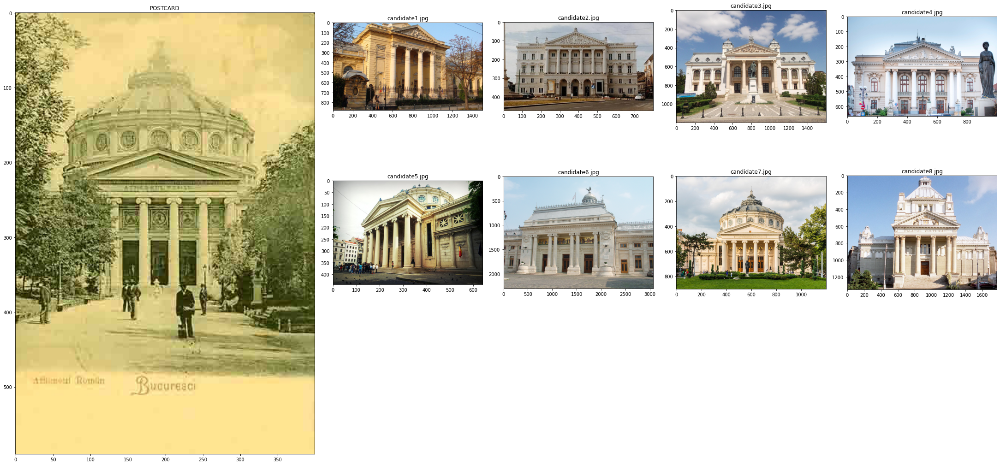

In [6]:
list_photos_files = glob.glob(FOLDER_IMAGES + "candidate*.jpg")

view_grid_images(postcard_image = FOLDER_IMAGES + "postcard2.jpg", list_photos = sorted(list_photos_files))

It's quite challenging, since all photos were chosen to have architectural elements of classicism/neo-classicism.  
Hint: candidate5.jpg and candidate7.jpg are the correct answers.


## Read and prepare image

In [7]:
def read_and_prepare_image(img_filename, crop_bbox = None):
    """read image from img_filename and optionally crop a bbox. 
       Finally, rescale image to have the largest edge 500 """

    img1 = cv2.imread(FOLDER_IMAGES + img_filename)  
    img1_rgb = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
    if crop_bbox is not None:
        img1_cut = img1_rgb[crop_bbox[0]:crop_bbox[1], crop_bbox[2]:crop_bbox[3]]
    else:
        img1_cut = img1_rgb[:,:]

    width = img1_cut.shape[0]
    height = img1_cut.shape[1]
    #print("size: w x h = {} x {}".format(width, height) )
    min_wh = min(width, height)
    if min_wh > 500:
        if width > height:
            #resize with aspect preservation, so that width becomes 500
            r = 500 / float(width)
            new_width = 500
            new_height = int(height * r)
        else:
            #resize with aspect preservation, so that height becomes 500
            r = 500 / float(height)
            new_width = int(width * r)
            new_height = 500 

        img1_resized = cv2.resize(img1_cut, (new_height,new_width), interpolation =  cv2.INTER_NEAREST)
    else:
        img1_resized = img1_cut

    return img1_resized

In [8]:
img1_cut_postcard = read_and_prepare_image(img_filename = "postcard2.jpg", crop_bbox = [0,370,50,350])
print(img1_cut_postcard.shape)

(370, 300, 3)


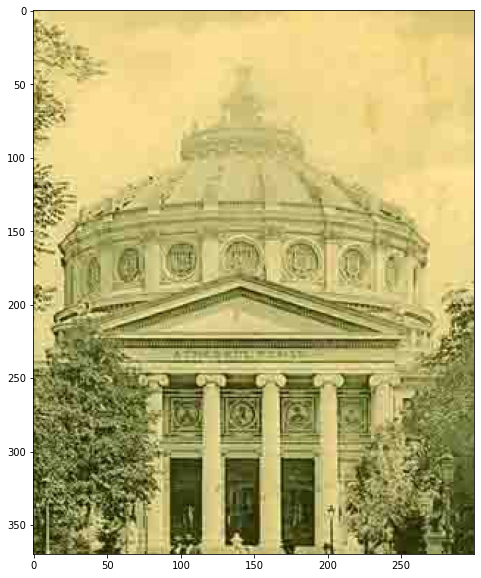

In [9]:
fig, ax = plt.subplots(1,1, figsize = (10,10))
ax.imshow(img1_cut_postcard)

## Compute salient points and local image descriptors

Salient point (aka keypoint) is an important "circular image region with an orientation"[1]. It is described by 4 parameters [1]:
- center coordinates x and y, 
- scale (the radius of the region), 
- orientation (an angle expressed in radians).

Keypoint descriptor = local feature that encodes the texture patch around the salient point 


[1] https://www.vlfeat.org/api/sift.html


Methods:

- Scale Invariant Feature Transform (SIFT) 
- Speed  up  Robust  Feature (SURF) 
- Binary Robust  Independent  Elementary  Features (BRIEF)
- Oriented FASTand   Rotated   BRIEF (ORB)
- KAZE
- AKAZE
- Binary Robust Invariant Scalable Keypoints (BRISK)
- Fast Retina Keypoint (FREAK)



Advantages:

- localized features, able to capture more context;
- explainability;
- fairly robust to image transformations (e.g. rotation, scaling, brightness, etc)

Disadvantages:

- challenges in using them for image matching, when each image has a set of keypoints descriptors and pertinent correspondences must be found between items of these sets. This is especially challenging when large camera angles or in case of repetitive structures in the image ("repeated patterns: the curse of perceptual aliasing") [2], [3];
- there are multiple descriptors for an image, so the relationship file - to - descriptors must be managed;
- memory footprint and computation time

[2] https://www.researchgate.net/publication/281657906_Image_point_correspondences_and_repeated_patterns  
[3] https://doi.org/10.1016/j.knosys.2020.105871   




In [10]:
sift = cv2.xfeatures2d_SIFT.create()
surf = cv2.xfeatures2d_SURF.create(hessianThreshold = 400)
star = cv2.xfeatures2d.StarDetector_create()
brief = cv2.xfeatures2d.BriefDescriptorExtractor_create()
orb = cv2.ORB_create() 
kaze = cv2.KAZE_create()
akaze = cv2.AKAZE_create()
brisk = cv2.BRISK_create()
freak = cv2.xfeatures2d.FREAK_create()

#for BRIEF and FREAK it's 2-stage , so needs special processing
dict_detectors = {"SIFT": sift, "SURF": surf, "ORB":orb, 
                  "KAZE":kaze, "AKAZE":akaze,"BRISK":brisk, 
                  "FREAK": None, "BRIEF": None}

### Compute keypoints and local descriptors for the postcard

In [11]:
#sidenote - how it works
a = [1,2,3,3,4,3,3,2,1]
a_ord = np.argsort(a)
print("the indices that would sort the previous list:", a_ord)
print("sorted list (asc):", [a[el] for el in a_ord])
print("sorted list (desc):", [a[el] for el in a_ord[::-1] ])
print("---------------------------------------------------------")

a_ord2 = np.argsort(a_ord)
print("ranks (the pos the item would have in the sorted list):", a_ord2)


the indices that would sort the previous list: [0 8 1 7 2 3 5 6 4]
sorted list (asc): [1, 1, 2, 2, 3, 3, 3, 3, 4]
sorted list (desc): [4, 3, 3, 3, 3, 2, 2, 1, 1]
---------------------------------------------------------
ranks (the pos the item would have in the sorted list): [0 2 4 5 8 6 7 3 1]


In [12]:
def compute_keypoints_and_descriptors(img1_rgb, method, flag_debug = False):
    """for the RGB image of input, compute salient points and their descriptors using the specified method.
       returns a dict with keys "keypoints", "descriptors", "ranks_relevancies_desc", "method" 
    """

  
    dict_keypoints = {}
    dict_descriptors = {} 
    #convert to grayscale
    gray1 = cv2.cvtColor(img1_rgb, cv2.COLOR_BGR2GRAY)

    if method not in ["BRIEF", "FREAK"]:
        the_detector = dict_detectors[method]
        keypoints, descriptors = the_detector.detectAndCompute(gray1,None)
    elif method == "BRIEF":
        #STAR & BRIEF
        STAR_kp = star.detect(gray1,None)
        keypoints, descriptors = brief.compute(gray1, STAR_kp)
    elif method == "FREAK":
        #it needs the keypoints to be detected with another method, then it computes the descriptors
        the_detector = dict_detectors["SURF"]
        keypoints, _ = the_detector.detectAndCompute(gray1,None)
        keypoints, descriptors = freak.compute(gray1, keypoints)
        

    #rank the keypoints in descending order of relevance
    list_relevancies = [x.response for x in keypoints] 
    #the argsort returns the indices that would sort an array
    ranks_relevancies_asc = np.argsort(list_relevancies)
    #reverse order to get them in descending order
    ranks_relevancies_desc = ranks_relevancies_asc[::-1]

    
    if flag_debug is True:
        #debug to see details
        print("The file has {} keypoints and {} descriptors of length {} each".format(len(keypoints), descriptors.shape[0], descriptors.shape[1]))
        print("------------------------")
        print(" Sample of 10 keypoints:")
        print("------------------------")
        for j in range(10):
            kp = keypoints[j]
            print("Keypoint :", kp.pt, " has relevance:", kp.response)

        print("------------------------")
        print(" Most relevant 10 kps:  ")
        print("------------------------")

        for j in range(10):
            kp = keypoints[ranks_relevancies_desc[j]]
            print("Keypoint : {} has size: {}, angle: {}, relevance: {} ".format(kp.pt, kp.size, kp.angle, kp.response))

        print("-------------------------")
        print(" Sample of 2 descriptors:")
        print("-------------------------")
        print("First Descriptor:\n", descriptors[0] )
        print("Second Descriptor:\n", descriptors[1] )


    dict_result_local_descriptors = {"keypoints": keypoints,
                                     "descriptors": descriptors,
                                     "ranks_relevancies_desc": ranks_relevancies_desc,
                                     "method": method}
    return dict_result_local_descriptors

In [13]:
dict_result_local_descriptors_KAZE  = compute_keypoints_and_descriptors(img1_rgb = img1_cut_postcard, 
                                                                        method = "KAZE", flag_debug = True)

The file has 560 keypoints and 560 descriptors of length 64 each
------------------------
 Sample of 10 keypoints:
------------------------
Keypoint : (1.8284305334091187, 8.097037315368652)  has relevance: 0.001189081696793437
Keypoint : (15.086374282836914, 15.255945205688477)  has relevance: 0.0012588255340233445
Keypoint : (3.0519182682037354, 58.773616790771484)  has relevance: 0.00147705536801368
Keypoint : (6.139775276184082, 64.95064544677734)  has relevance: 0.0010966714471578598
Keypoint : (19.963151931762695, 73.12261962890625)  has relevance: 0.0012124116765335202
Keypoint : (102.97428894042969, 99.37210083007812)  has relevance: 0.0010611029574647546
Keypoint : (1.7133455276489258, 118.34038543701172)  has relevance: 0.0015188120305538177
Keypoint : (21.026573181152344, 118.3613510131836)  has relevance: 0.0011468316661193967
Keypoint : (9.05848217010498, 118.85047912597656)  has relevance: 0.0013965824618935585
Keypoint : (15.334839820861816, 123.75502014160156)  has rele

In [14]:
def view_patches_of_local_descriptors(img1_rgb, dict_result_local_descriptors):
    """ for the input RGB image, extract and visulize the patches corresponding to 
        the salient points("keypoints" key in dict_result_local_descriptors)
    """

    method = dict_result_local_descriptors["method"]  
    keypoints1 = dict_result_local_descriptors["keypoints"]  
    descriptors1 = dict_result_local_descriptors["descriptors"]  
    ranks_relevancies_desc1 = dict_result_local_descriptors["ranks_relevancies_desc"]  
    
    dict_mrsize = {"ORB": 1.0, "SIFT": 6.0, "KAZE": 3.0, "SURF":1.0}
    mrSize = dict_mrsize[method]
    PATCH_SIZE = 50

    #convert to grayscale
    img1_gray = cv2.cvtColor(img1_rgb, cv2.COLOR_BGR2GRAY)

    topn_relevant = 40
    topn_keypoints = [keypoints1[j] for j in ranks_relevancies_desc1[0:topn_relevant]]
    print("top{} keypoints in descending order of their importance are at indices:".format(topn_relevant),
          [j for j in ranks_relevancies_desc1[0:topn_relevant]])
    print("relevancy of selected keypoints:", [round(el.response,3) for el in topn_keypoints] )
    print("size(radius) of selected keypoints:", [round(el.size,3) for el in topn_keypoints] )

    img1_circles = cv2.drawKeypoints(img1_gray, topn_keypoints, img1_gray, color=(255, 0, 0), 
                                     flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

    #extract patches around the keypoints
    patches = extract_patches(topn_keypoints, img1_rgb, PATCH_SIZE, mrSize, 'cv2') 

    view_grid_images(postcard_image = img1_circles, list_photos = patches, 
                     num_cols_grid_photos=8, num_cols_reserved = 3, with_titles= False)


top40 keypoints in descending order of their importance are at indices: [441, 393, 388, 556, 486, 551, 485, 506, 331, 425, 488, 391, 558, 204, 191, 431, 474, 487, 471, 499, 396, 327, 545, 330, 472, 328, 210, 332, 390, 357, 489, 395, 398, 469, 440, 302, 375, 470, 504, 540]
relevancy of selected keypoints: [0.017, 0.012, 0.011, 0.01, 0.01, 0.01, 0.009, 0.009, 0.008, 0.008, 0.008, 0.008, 0.008, 0.007, 0.007, 0.007, 0.007, 0.007, 0.007, 0.007, 0.006, 0.006, 0.006, 0.006, 0.006, 0.006, 0.006, 0.006, 0.006, 0.006, 0.006, 0.006, 0.006, 0.006, 0.006, 0.006, 0.006, 0.006, 0.005, 0.005]
size(radius) of selected keypoints: [10.055, 5.76, 5.869, 20.188, 9.842, 16.502, 9.794, 9.925, 5.82, 7.683, 10.007, 5.822, 30.251, 3.472, 3.486, 8.199, 9.464, 10.008, 9.454, 8.592, 5.444, 5.844, 17.675, 5.836, 9.305, 5.883, 3.475, 5.862, 5.712, 5.617, 8.948, 5.735, 5.801, 9.497, 7.683, 5.814, 5.783, 9.458, 9.533, 19.557]
We'll have a grid of 5 x 11 of which 4 x 3 reserved for postcard


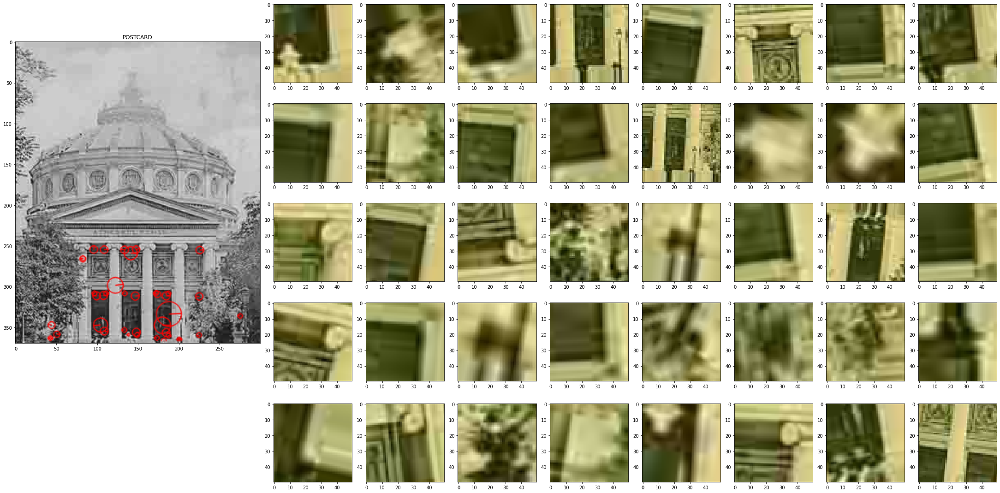

In [15]:
view_patches_of_local_descriptors(img1_rgb = img1_cut_postcard,
                                  dict_result_local_descriptors = dict_result_local_descriptors_KAZE)

### Comparison between methods - all applied on the postcard image

In [16]:
%%time
#postcard_kpdescr_all_methods will be a list of dict, each dict being the result returned by
# compute_keypoints_and_descriptors for a given method among SIFT, SURF, etc
# the method name is stored as part of each dict 

postcard_kpdescr_all_methods = []

for the_method in dict_detectors:
    dict_result_local_descriptors_  = compute_keypoints_and_descriptors(img1_rgb = img1_cut_postcard, 
                                                                        method = the_method, flag_debug = False)
    postcard_kpdescr_all_methods.append(dict_result_local_descriptors_)

CPU times: user 1.17 s, sys: 29.9 ms, total: 1.2 s
Wall time: 693 ms


In [17]:
#understanding the data structure used
#enumerate method of each dict in list
print([el["method"] for el in postcard_kpdescr_all_methods])

#filter list to take only dict for KAZE method, then print keys of this dict
print([el.keys() for el in postcard_kpdescr_all_methods if el["method"] == "KAZE"])


['SIFT', 'SURF', 'ORB', 'KAZE', 'AKAZE', 'BRISK', 'FREAK', 'BRIEF']
[dict_keys(['keypoints', 'descriptors', 'ranks_relevancies_desc', 'method'])]


In [18]:
def visualize_descriptors_comparison(img1_rgb, list_kpdescr_all_methods, topn_relevant = None):
    """ for input RGB image, plot the (topn_relevant) salient points for each method present in  list_kpdescr_all_methods
    """

    #convert to grayscale
    gray1 = cv2.cvtColor(img1_rgb, cv2.COLOR_BGR2GRAY)

    fig = plt.figure(figsize=(24,12))
    i = 1
    for dict_result_local_descriptors in list_kpdescr_all_methods:
        method = dict_result_local_descriptors["method"]  
        keypoints1 = dict_result_local_descriptors["keypoints"]  
        descriptors1 = dict_result_local_descriptors["descriptors"]  
        ranks_relevancies_desc1 = dict_result_local_descriptors["ranks_relevancies_desc"]  

        keypoints_sizes_arr = np.array([kp.size for kp in keypoints1])
        s = "{}  identified   {}   salient points ; size(radius) in [{} , {}]"
        print(s.format(method.ljust(10), len(keypoints1), 
                       round(keypoints_sizes_arr.min(),3),  round(keypoints_sizes_arr.max(),3) ))
    
        if topn_relevant is None:
            #plot all local keypoints
            img_1 = cv2.drawKeypoints(gray1, keypoints1, gray1, color=(277, 0, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        else:
            topn_keypoints = [keypoints1[j] for j in ranks_relevancies_desc1[0:topn_relevant]]
            img_1 = cv2.drawKeypoints(gray1, topn_keypoints, gray1, color=(255, 0, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

        ax = fig.add_subplot(2,4,i)
        ax.imshow(img_1)
        ax.set_title(method)
        ax.set_axis_off()
        i = i + 1

    fig.tight_layout()

First, plot all keypoints of each method:

SIFT        identified   1142   salient points ; size(radius) in [1.797 , 48.567]
SURF        identified   837   salient points ; size(radius) in [12.0 , 127.0]
ORB         identified   487   salient points ; size(radius) in [31.0 , 111.079]
KAZE        identified   560   salient points ; size(radius) in [3.299 , 30.251]
AKAZE       identified   329   salient points ; size(radius) in [4.8 , 16.145]
BRISK       identified   2100   salient points ; size(radius) in [8.4 , 72.0]
FREAK       identified   380   salient points ; size(radius) in [12.0 , 44.0]
BRIEF       identified   69   salient points ; size(radius) in [4.0 , 22.0]


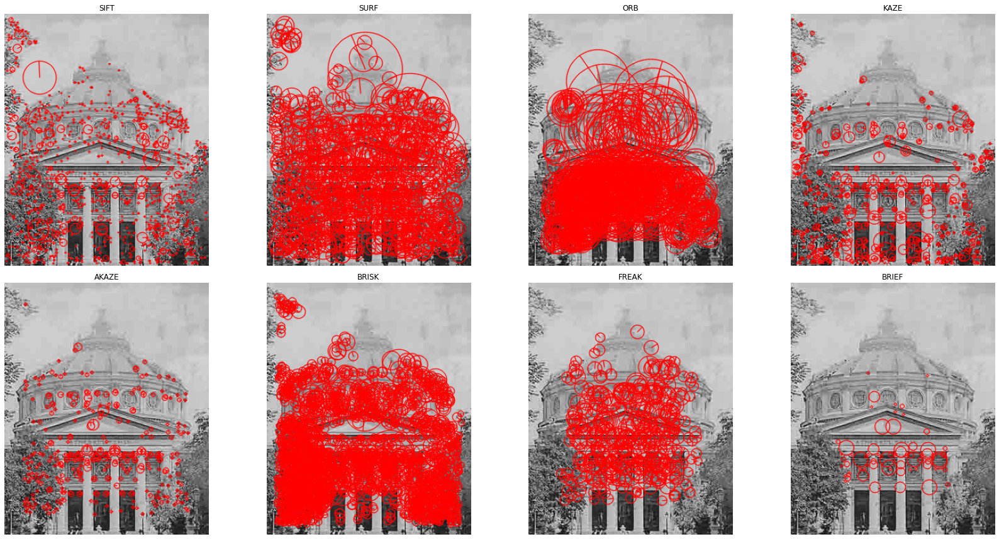

In [19]:
visualize_descriptors_comparison(img1_rgb = img1_cut_postcard,
                                 list_kpdescr_all_methods = postcard_kpdescr_all_methods)

Note the difference beteen SURF and SURF + FREAK.

We want to visually compare the distributions of keypoint size (radius) across the various methods:


In [20]:
def visually_compare_radius_distrib(list_kpdescr_all_methods, cumulative_flag = False):
    fig = plt.figure(figsize=(20, 6))
    i = 1 
    for dict_result_local_descriptors in list_kpdescr_all_methods:
        method = dict_result_local_descriptors["method"]
        keypoints = dict_result_local_descriptors["keypoints"]
        keypoints_sizes_arr = np.array([kp.size for kp in keypoints])
        max_radius = keypoints_sizes_arr.max()

        ax = fig.add_subplot(2,4,i)
        #to make it comparable, choose the same bins
        bin_width = 5
        bins = [ii * 5 for ii in range(math.ceil(max_radius/bin_width))]
        #print(method, bins)
        sns.histplot(keypoints_sizes_arr, bins = bins, 
                     stat="probability", cumulative = cumulative_flag, 
                    facecolor="lightblue", ax = ax)
        ax.set_title(method)
        #set ticks to be the items at even positions in the list bins (i.e the multiples of 10 in our case) 
        ax.set_xticks(bins[::2])
        ax.set_xlabel("Keypoint size(radius)")
        i += 1 
    fig.tight_layout()

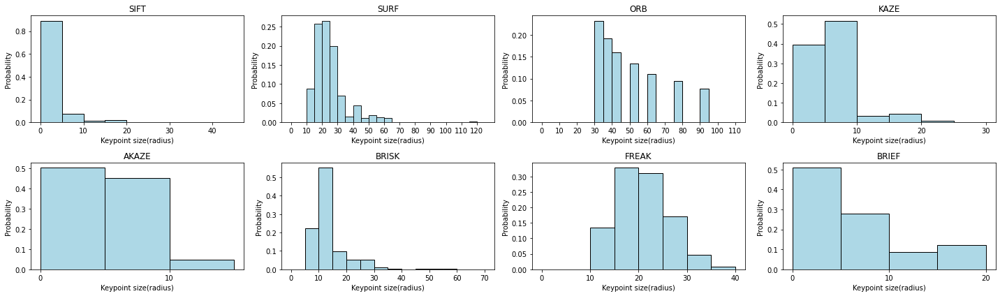

In [21]:
visually_compare_radius_distrib(list_kpdescr_all_methods = postcard_kpdescr_all_methods, 
                                cumulative_flag = False)

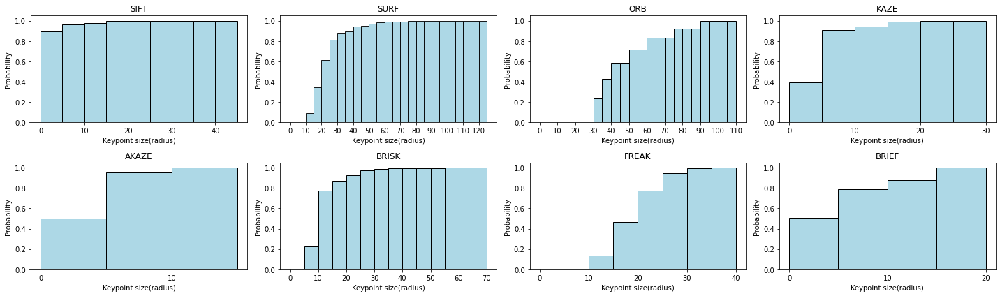

In [22]:
visually_compare_radius_distrib(list_kpdescr_all_methods = postcard_kpdescr_all_methods, 
                                cumulative_flag = True)

Next we plot joint distribution keypoint size(radius) and keypoint relevancy(response) by method.

We also compute Spearman rank-order correlation coefficient and the p-value for testing monotonicity of the relationship between these 2 continuous variables.

note: Unlike the Pearson correlation, the Spearman correlation does not assume that both datasets are normally distributed. 
    

method SIFT       --> r=-0.158     pvalue=0.0
method SURF       --> r=0.062     pvalue=0.073
method ORB        --> r=-0.813     pvalue=0.0
method KAZE       --> r=0.297     pvalue=0.0
method AKAZE      --> r=0.167     pvalue=0.002
method BRISK      --> r=-0.042     pvalue=0.052
method FREAK      --> r=0.073     pvalue=0.155
method BRIEF      --> r=-0.212     pvalue=0.08


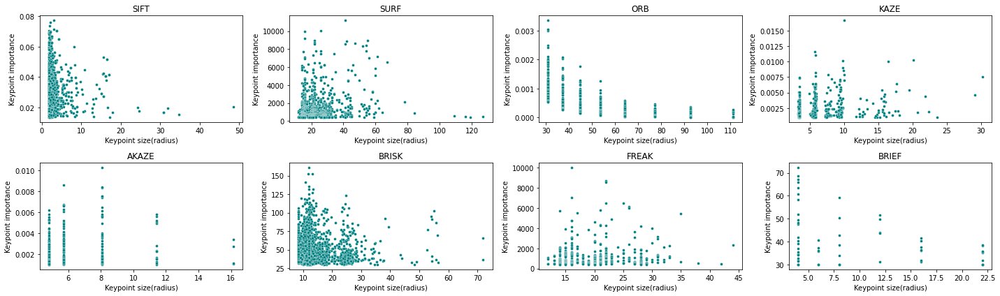

In [23]:
fig = plt.figure(figsize=(20,6))
i = 1 
for dict_result_local_descriptors in postcard_kpdescr_all_methods:
    method = dict_result_local_descriptors["method"]
    keypoints = dict_result_local_descriptors["keypoints"]
    keypoints_sizes_arr = [kp.size for kp in keypoints]
    keypoints_relevancy_arr = [kp.response for kp in keypoints]

    r = scipy.stats.spearmanr(a = keypoints_sizes_arr, b = keypoints_relevancy_arr)
    print("method {} --> r={}     pvalue={}".format(method.ljust(10), round(r[0], 3), round(r[1], 3)))

    ax = fig.add_subplot(2,4,i)
    sns.scatterplot(x=keypoints_sizes_arr, y = keypoints_relevancy_arr, ax = ax,
                    s=15, color="teal")
    ax.set_title(method)
    ax.set_xlabel("Keypoint size(radius)")
    ax.set_ylabel("Keypoint importance")
    i += 1 
fig.tight_layout()

Secondly, plot top 100 keypoints considered most relevant for each method:

SIFT        identified   1142   salient points ; size(radius) in [1.797 , 48.567]
SURF        identified   837   salient points ; size(radius) in [12.0 , 127.0]
ORB         identified   487   salient points ; size(radius) in [31.0 , 111.079]
KAZE        identified   560   salient points ; size(radius) in [3.299 , 30.251]
AKAZE       identified   329   salient points ; size(radius) in [4.8 , 16.145]
BRISK       identified   2100   salient points ; size(radius) in [8.4 , 72.0]
FREAK       identified   380   salient points ; size(radius) in [12.0 , 44.0]
BRIEF       identified   69   salient points ; size(radius) in [4.0 , 22.0]


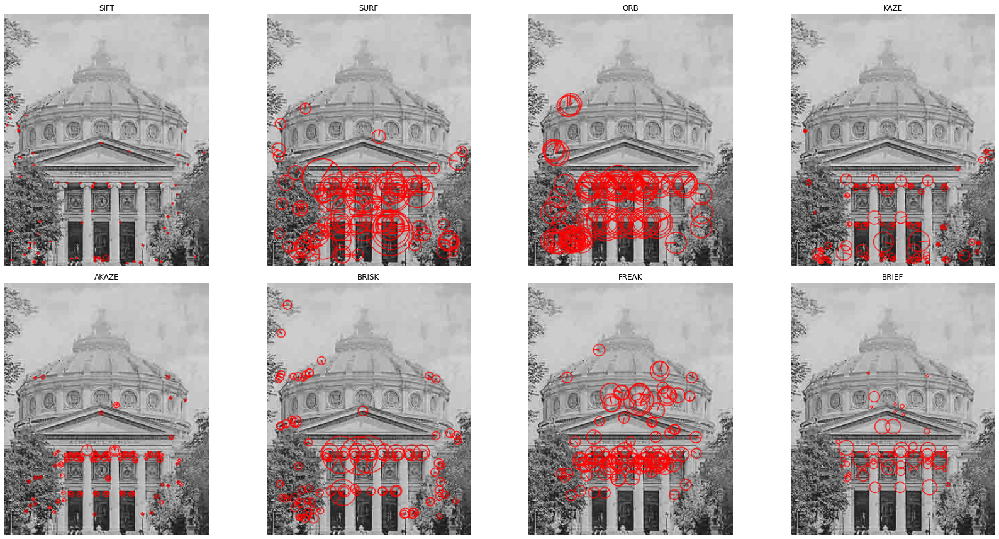

In [24]:
visualize_descriptors_comparison(img1_rgb = img1_cut_postcard,
                                 list_kpdescr_all_methods = postcard_kpdescr_all_methods,
                                 topn_relevant=100)

Interesting, the spatial distribution of these over the image.

In [25]:
#for each method, inspect the shape and datatype of the descriptors (will be used in later postprocessing)
dict_dtype_descriptors = {}

for dict_result_local_descriptors in postcard_kpdescr_all_methods:
    method = dict_result_local_descriptors["method"]
    keypoints = dict_result_local_descriptors["keypoints"]
    descriptors = dict_result_local_descriptors["descriptors"]
    print("****** Method: {} descriptor shape:{} and dtype:{}".format(method, descriptors[0].shape, descriptors[0].dtype), "\n")
    dict_dtype_descriptors[method] = str(descriptors[0].dtype)
    #print(descriptors[0])
    #print("\n")
    


****** Method: SIFT descriptor shape:(128,) and dtype:float32 

****** Method: SURF descriptor shape:(64,) and dtype:float32 

****** Method: ORB descriptor shape:(32,) and dtype:uint8 

****** Method: KAZE descriptor shape:(64,) and dtype:float32 

****** Method: AKAZE descriptor shape:(61,) and dtype:uint8 

****** Method: BRISK descriptor shape:(64,) and dtype:uint8 

****** Method: FREAK descriptor shape:(64,) and dtype:uint8 

****** Method: BRIEF descriptor shape:(32,) and dtype:uint8 



### Compute the keypoints and local descriptors for the photos images

In [26]:
list_photos_files = glob.glob(FOLDER_IMAGES + "candidate*.jpg")

#dict_kpdescr_photos will be a dict keyed by photo filename. The value for a given key will be a list of dicts - one dict per method,
# similar to what we did for the postcard
dict_kpdescr_photos = {}

for photo_img_filepath in list_photos_files:
    photo_img_filename = photo_img_filepath.split("/")[-1]
    img1_photo = read_and_prepare_image(img_filename = photo_img_filename)
    photo_kpdescr_all_methods = []

    for the_method in dict_detectors:
        dict_result_local_descriptors_  = compute_keypoints_and_descriptors(img1_rgb = img1_photo, 
                                                                            method = the_method, flag_debug = False)
        photo_kpdescr_all_methods.append(dict_result_local_descriptors_)
    dict_kpdescr_photos[photo_img_filename] = photo_kpdescr_all_methods



In [27]:
#an entry in this dict
list_kpdescr_all_methods_photo7 = dict_kpdescr_photos["candidate7.jpg"]
for item in list_kpdescr_all_methods_photo7:
    print(type(item), item.keys())
    print(item["method"])
    print(item["ranks_relevancies_desc"])
    print("---------")

<class 'dict'> dict_keys(['keypoints', 'descriptors', 'ranks_relevancies_desc', 'method'])
SIFT
[1123 1122 1121 ...  385  629  630]
---------
<class 'dict'> dict_keys(['keypoints', 'descriptors', 'ranks_relevancies_desc', 'method'])
SURF
[   0    1    2 ... 1717 1718 1719]
---------
<class 'dict'> dict_keys(['keypoints', 'descriptors', 'ranks_relevancies_desc', 'method'])
ORB
[  8  19   2   3  15  28   1  30  20   9  12  51  32  37  23  36  46  34
  35  13  17  26 140  38 118   7  43  22  24  44 128  48  11   6   5  52
  45  40 125  42  14  21  39 122  29  27  18  10  33  47 117   4  49  41
  25  31  16  50   0 212 120  77 124  90 104  70  80 102  68 141 101  56
  60 112  88  58  64 103 213 119  94  87  71 205  86 100  89  91  96 201
  59 123  67  81 221  85  61 146 210 222  63  75 129  69  93  82 142  84
 116 139  62 145  66  73 131 115 126 113 147  83 137  99 211  97  55  92
 138  65  76  57 208  78 150  98  72 204 132  95 111 121 217 114 136 135
 130 127 148 144 306  54 218 105 220 

Visualize results for some photos:

SIFT        identified   1331   salient points ; size(radius) in [1.799 , 65.018]
SURF        identified   1720   salient points ; size(radius) in [11.0 , 169.0]
ORB         identified   500   salient points ; size(radius) in [31.0 , 111.079]
KAZE        identified   1642   salient points ; size(radius) in [3.21 , 33.839]
AKAZE       identified   1215   salient points ; size(radius) in [4.8 , 16.145]
BRISK       identified   6592   salient points ; size(radius) in [8.4 , 72.0]
FREAK       identified   1067   salient points ; size(radius) in [11.0 , 55.0]
BRIEF       identified   389   salient points ; size(radius) in [4.0 , 32.0]


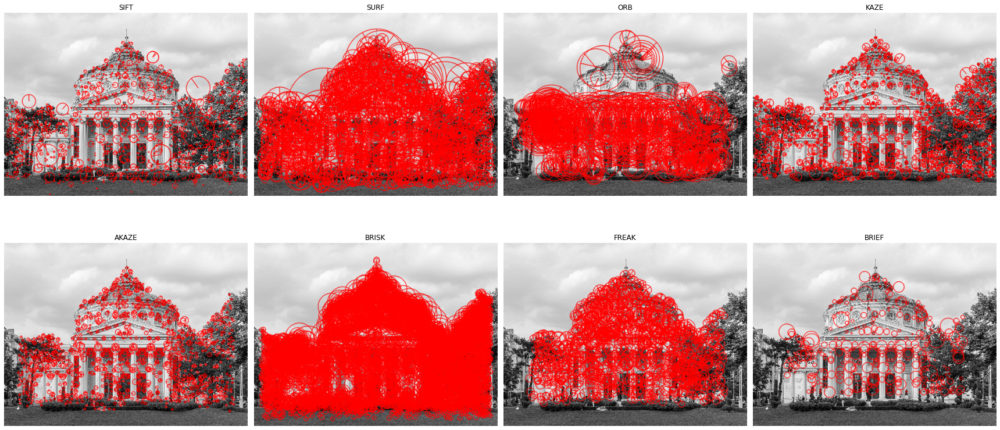

In [28]:
img1_photo7 = read_and_prepare_image(img_filename = "candidate7.jpg")
visualize_descriptors_comparison(img1_rgb = img1_photo7,
                                 list_kpdescr_all_methods = dict_kpdescr_photos["candidate7.jpg"], 
                                 topn_relevant=None)

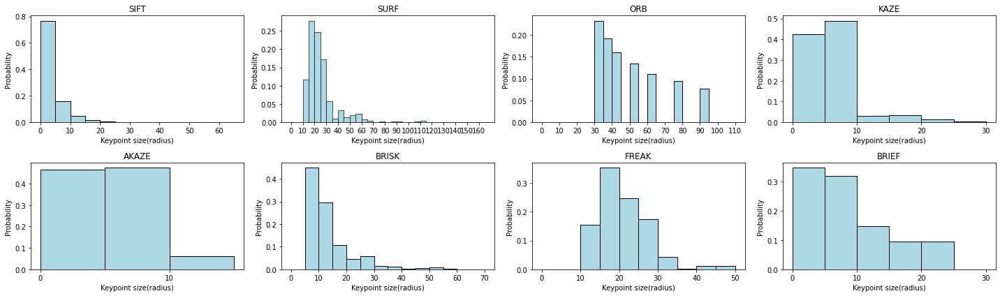

In [29]:
visually_compare_radius_distrib(list_kpdescr_all_methods = dict_kpdescr_photos["candidate7.jpg"], 
                                cumulative_flag = False)

**ANOTHER ILLUSTRATION**

SIFT        identified   1159   salient points ; size(radius) in [1.797 , 43.175]
SURF        identified   1199   salient points ; size(radius) in [10.0 , 224.0]
ORB         identified   500   salient points ; size(radius) in [31.0 , 111.079]
KAZE        identified   1197   salient points ; size(radius) in [3.262 , 38.467]
AKAZE       identified   767   salient points ; size(radius) in [4.8 , 16.145]
BRISK       identified   2903   salient points ; size(radius) in [8.4 , 72.0]
FREAK       identified   589   salient points ; size(radius) in [10.0 , 46.0]
BRIEF       identified   252   salient points ; size(radius) in [4.0 , 32.0]


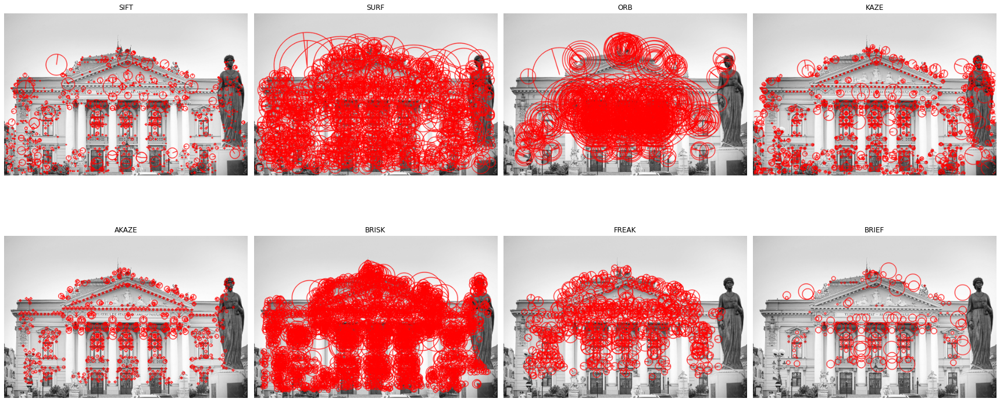

In [30]:
img1_photo4 = read_and_prepare_image(img_filename = "candidate4.jpg")
visualize_descriptors_comparison(img1_rgb = img1_photo4,
                                 list_kpdescr_all_methods = dict_kpdescr_photos["candidate4.jpg"], 
                                 topn_relevant=None)

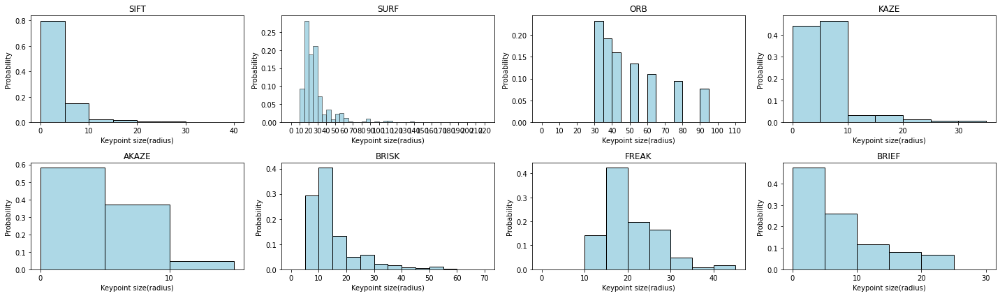

In [31]:
visually_compare_radius_distrib(list_kpdescr_all_methods = dict_kpdescr_photos["candidate4.jpg"], 
                                cumulative_flag = False)

**ANOTHER ILLUSTRATION:**

SIFT        identified   1185   salient points ; size(radius) in [1.81 , 76.602]
SURF        identified   1576   salient points ; size(radius) in [12.0 , 226.0]
ORB         identified   500   salient points ; size(radius) in [31.0 , 111.079]
KAZE        identified   1207   salient points ; size(radius) in [3.24 , 37.66]
AKAZE       identified   861   salient points ; size(radius) in [4.8 , 22.833]
BRISK       identified   3935   salient points ; size(radius) in [8.4 , 72.0]
FREAK       identified   890   salient points ; size(radius) in [13.0 , 57.0]
BRIEF       identified   294   salient points ; size(radius) in [4.0 , 32.0]


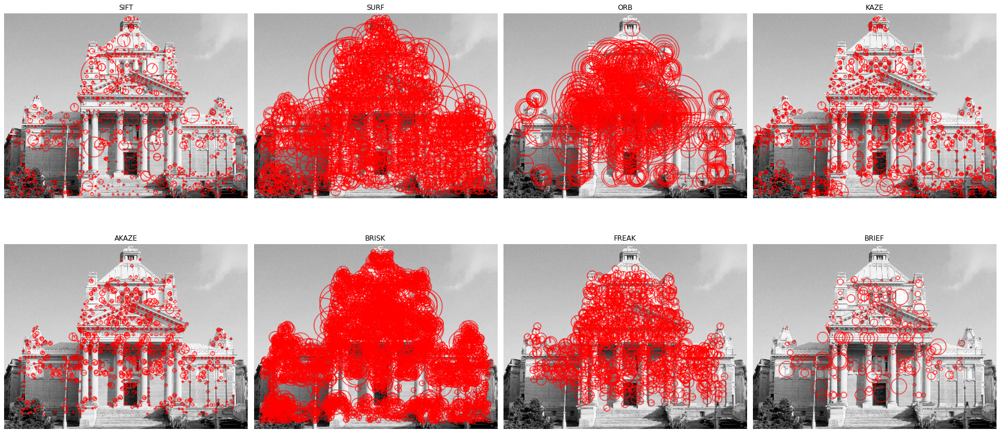

In [32]:
img1_photo8 = read_and_prepare_image(img_filename = "candidate8.jpg")
visualize_descriptors_comparison(img1_rgb = img1_photo8,
                                 list_kpdescr_all_methods = dict_kpdescr_photos["candidate8.jpg"], 
                                 topn_relevant=None)

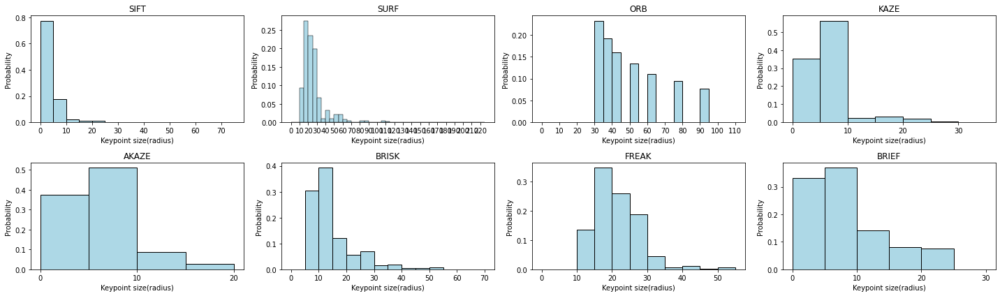

In [33]:
visually_compare_radius_distrib(list_kpdescr_all_methods = dict_kpdescr_photos["candidate8.jpg"], 
                                cumulative_flag = False)

Note: while ORB always identifies 500 keypoints (always with radius greater thn 30), the other methods adapt their number of keypoints to the complexity of the image under study.

## Brute Force Matcher to extract correspondences between salient points in postcard and those in photos

In [34]:
#remember
dict_dtype_descriptors

{'AKAZE': 'uint8',
 'BRIEF': 'uint8',
 'BRISK': 'uint8',
 'FREAK': 'uint8',
 'KAZE': 'float32',
 'ORB': 'uint8',
 'SIFT': 'float32',
 'SURF': 'float32'}

In [35]:
print([el for el in list(dir(cv2.BFMatcher)) if el[0]!="_"], "\n")

help(cv2.BFMatcher.create)
#help(cv2.BFMatcher.radiusMatch)

['add', 'clear', 'clone', 'create', 'empty', 'getDefaultName', 'getTrainDescriptors', 'isMaskSupported', 'knnMatch', 'match', 'radiusMatch', 'read', 'save', 'train', 'write'] 

Help on built-in function create:

create(...) method of builtins.type instance
    create([, normType[, crossCheck]]) -> retval
    .   @brief Brute-force matcher create method.
    .   @param normType One of NORM_L1, NORM_L2, NORM_HAMMING, NORM_HAMMING2. L1 and L2 norms are
    .   preferable choices for SIFT and SURF descriptors, NORM_HAMMING should be used with ORB, BRISK and
    .   BRIEF, NORM_HAMMING2 should be used with ORB when WTA_K==3 or 4 (see ORB::ORB constructor
    .   description).
    .   @param crossCheck If it is false, this is will be default BFMatcher behaviour when it finds the k
    .   nearest neighbors for each query descriptor. If crossCheck==true, then the knnMatch() method with
    .   k=1 will only return pairs (i,j) such that for i-th query descriptor the j-th descriptor in the
    

Note: quote from [5]:

> "boolean variable, crossCheck is false by default. If it is true, BFMatcher returns only those matches with value (i,j) such that i-th descriptor in set A has j-th descriptor in set B as the best match and vice-versa."

[5] https://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_feature2d/py_matcher/py_matcher.html


if we keep crossCheck false, then a "ratio test" should later be performed to eliminate cases when a postcard keypoint has approx same distance to 2 nearest keypoints in photo image. Nicely explained in [6], the rationale beyond this being:

> "Working from the assumption that a keypoint in image 1 can't have more than one equivalent in image 2, we deduce that those two matches can't both be right: at least one of them is wrong. [...]  So the general principle is that there needs to be enough difference between the best and second-best matches."

[6] https://stackoverflow.com/questions/51197091/how-does-the-lowes-ratio-test-work


Yet in our repetitive setting of the building with repetitive architectural elements (such as pillars), the hypothesis isn't met.

We investigate each of the options of finding correspondences: default matching, knn matching (requires post-filtering), radius based matching (requires post-filtering) :

In [36]:
class Matcher:
    #depending on the datatype o the local descriptors, the appropriate metric is used
    dict_matchers ={ "float32":
                     {"v1": cv2.BFMatcher(normType = cv2.NORM_L2, crossCheck=True),
                      "v2": cv2.BFMatcher(normType = cv2.NORM_L2, crossCheck=False)
                     },
                     "uint8" :
                     {"v1": cv2.BFMatcher(normType = cv2.NORM_HAMMING, crossCheck=True),
                      "v2": cv2.BFMatcher(normType = cv2.NORM_HAMMING, crossCheck=False) 
                     }
    }
    matches = None
    matcher_kind = None

    def __init__(self, method, version):
        self.bf_matcher =  self.dict_matchers[dict_dtype_descriptors[method]][version]

    def compute_matches_knn(self, descriptors1, descriptors2, k):
        """for each training point, it initially finds k best matches from the query set,
           then we apply ratio test to keep good matches.
           note: when k = 1, it gives results similar to compute_matches above"""
        self.matches = self.bf_matcher.knnMatch(descriptors1, descriptors2, k = k)
        self.matcher_kind = "knn"     


    def compute_matches_radius(self, descriptors1, descriptors2, radius):
        self.matches = self.bf_matcher.radiusMatch(descriptors1, descriptors2, 
                                                   maxDistance = radius)
        self.matcher_kind = "radius"


    def compute_matches(self, descriptors1, descriptors2):
        self.matches = self.bf_matcher.match(descriptors1, descriptors2)
        self.matcher_kind = "default"

    def get_matches(self):
        return self.matches


    def get_matches_flattened(self):
        list_matches = []
        if isinstance(self.matches[0], list):
            for a_matchlist in self.matches:
                for a_match in a_matchlist: 
                    list_matches.append(a_match)
        else:
            for a_match  in self.matches:
                list_matches.append(a_match)
        return list_matches


    def debug_matches(self):
        print("matcher_kind:", self.matcher_kind)
        print("matches has len:", len(self.matches))
        list_matches_flattened = self.get_matches_flattened()
        num_iterm_print = 0

        if isinstance(self.matches[0], list):
            s = "a match is a list with {} items , item type:{}"
            len_list = len(self.matches[0])
            types_items_list = [type(self.matches[0][i]) for i in range(len_list)]
            print(s.format(len_list, coll.Counter(types_items_list)))
            num_iterm_print = 20
        else:
            print("a match has type {}".format(type(self.matches[0]))) 
            print("Example of 10 matches:\n")
            num_iterm_print = 10
        
        l_aux =[ [str(a_match.queryIdx), str(a_match.trainIdx), a_match.distance]   
                                           for a_match in list_matches_flattened[0:num_iterm_print] ]
        print(tabulate(l_aux, headers = ["queryIdx","trainIdx","distance" ]))


In [37]:
def image_comparison(dict_result_local_descriptors_postcard, dict_result_local_descriptors_photo,
                     k = None, radius = None, debug_flag = False):
    
    #ensure both sicts of descriptors were generated with the same matcher_kind
    assert(dict_result_local_descriptors_postcard["method"] == dict_result_local_descriptors_photo["method"])
    method = dict_result_local_descriptors_postcard["method"]

    keypoints1 = dict_result_local_descriptors_postcard["keypoints"]  
    descriptors1 = dict_result_local_descriptors_postcard["descriptors"]  
    keypoints2 = dict_result_local_descriptors_photo["keypoints"]  
    descriptors2 = dict_result_local_descriptors_photo["descriptors"]  

    matcher = None

    if k is not None:
        #if k is provided, regarless of radius, go apply knn 
        matcher = Matcher(method = method, version = "v2")
        matcher.compute_matches_knn(descriptors1, descriptors2, k)
    elif radius is not None:
        matcher = Matcher(method = method, version = "v2")
        matcher.compute_matches_radius(descriptors1, descriptors2, radius + 0.0 )
    else:
        matcher = Matcher(method = method, version = "v1")
        matcher.compute_matches(descriptors1, descriptors2)
    
    if debug_flag is True:
        matcher.debug_matches()

    matches_result = matcher.get_matches_flattened()

    return matches_result


Similarities between postcard and candidate7, in all 3 matching ways, without post-match filtering:

In [38]:
#between the postcard and the good photo, using default bfmatching
method_ = "KAZE"
default_matches_postcard_photo7_KAZE = image_comparison(dict_result_local_descriptors_postcard = [el for el in postcard_kpdescr_all_methods
                                                                                                       if el["method"] == method_][0], 
                                                        dict_result_local_descriptors_photo = [el for el in dict_kpdescr_photos["candidate7.jpg"]
                                                                                                       if el["method"] == method_][0],
                                                        debug_flag = True)

print("\n flattened array has length:", len(default_matches_postcard_photo7_KAZE))

matcher_kind: default
matches has len: 407
a match has type <class 'cv2.DMatch'>
Example of 10 matches:

  queryIdx    trainIdx    distance
----------  ----------  ----------
         0        1566    0.472046
         1         811    0.543174
         2        1339    0.545543
         4         198    0.329251
         6         139    0.518344
         7          21    0.403184
         8        1613    0.520971
         9         736    0.425807
        10         288    0.438696
        11        1058    0.452991

 flattened array has length: 407


In [39]:
#between the postcard and the good photo, using knn-based matching
knn_matches_postcard_photo7_KAZE = image_comparison(dict_result_local_descriptors_postcard = [el for el in postcard_kpdescr_all_methods
                                                                                                       if el["method"] == method_][0], 
                                                        dict_result_local_descriptors_photo = [el for el in dict_kpdescr_photos["candidate7.jpg"]
                                                                                                       if el["method"] == method_][0],
                                                        k = 3, debug_flag = True)

print("\n flattened array has length:", len(knn_matches_postcard_photo7_KAZE))

matcher_kind: knn
matches has len: 560
a match is a list with 3 items , item type:Counter({<class 'cv2.DMatch'>: 3})
  queryIdx    trainIdx    distance
----------  ----------  ----------
         0        1566    0.472046
         0        1638    0.578964
         0        1524    0.600935
         1        1219    0.463974
         1           2    0.492093
         1        1504    0.503315
         2        1339    0.545543
         2          85    0.641449
         2        1163    0.680215
         3        1339    0.564535
         3        1346    0.611971
         3        1511    0.637507
         4         198    0.329251
         4         136    0.388787
         4         837    0.396205
         5        1509    0.402654
         5        1375    0.464985
         5         183    0.497019
         6         139    0.518344
         6         814    0.52986

 flattened array has length: 1680


In [40]:
#between the postcard and the good photo, using knn-based matching
radius_matches_postcard_photo7_KAZE = image_comparison(dict_result_local_descriptors_postcard = [el for el in postcard_kpdescr_all_methods
                                                                                                       if el["method"] == method_][0], 
                                                           dict_result_local_descriptors_photo = [el for el in dict_kpdescr_photos["candidate7.jpg"]
                                                                                                      if el["method"] == method_][0],
                                                           radius = 0.5, debug_flag = True)

print("\n flattened array has length:", len(radius_matches_postcard_photo7_KAZE))

matcher_kind: radius
matches has len: 560
a match is a list with 1 items , item type:Counter({<class 'cv2.DMatch'>: 1})
  queryIdx    trainIdx    distance
----------  ----------  ----------
         0        1566    0.472046
         1        1219    0.463974
         1           2    0.492093
         4         198    0.329251
         4         136    0.388787
         4         837    0.396205
         4         148    0.440957
         4         829    0.45566
         4        1362    0.491959
         4         846    0.497957
         5        1509    0.402654
         5        1375    0.464985
         5         183    0.497019
         7          21    0.403184
         7         721    0.428147
         7          27    0.432315
         7         626    0.442869
         7        1362    0.449749
         7        1368    0.462319
         7         714    0.46539

 flattened array has length: 6089


**Recap:** per postcard keypoint:
- default matching gives 0 or 1 corresponding keypoint in photo image
- knn matching gives k corresponding keypoints in photo image
- radius-based matching gives 0 or a variable number of corresponding keypoints in photo image

Note: for keypoint 2 in postcard, the results of corresponding keypoints in photo image were:
- default 

```
      2        1339    0.545543
```

- knn

```
      2        1339    0.545543
      2          85    0.641449
      2        1163    0.680215
```

- radius

```
     none
```

### Visualize matches

We use the knn results, in which each salient point in the postcard has 3 nearest (most similar) correspondences in the photo on the right. 

In [41]:
iith_kp_postcard = 551

#since we work with the knn result, each salient point on postcard has exactly 3 correspondances on the photo
k = 3
list_corresp = [knn_matches_postcard_photo7_KAZE[iith_kp_postcard*k+jj] for jj in range(k)]

for a_match in list_corresp:
    assert(isinstance(a_match, cv2.DMatch))
    print(a_match.queryIdx, a_match.trainIdx, a_match.distance)

551 1578 0.2902607321739197
551 1419 0.397713840007782
551 1420 0.4177556335926056


In [42]:
def explain_matches(img1_rgb_postcard, img1_rgb_photo, result_matches,
                    keypoints_postcard, keypoints_photo, k = 1, iith_kp_postcard = None ):
    """ here we use drawing functionality available out-of-the-box in opencv"""
    
    #convert to grayscale
    gray_postcard = cv2.cvtColor(img1_rgb_postcard, cv2.COLOR_BGR2GRAY)
    gray_photo = cv2.cvtColor(img1_rgb_photo, cv2.COLOR_BGR2GRAY)

    fig,ax = plt.subplots(1,1,figsize=(25,15))

    if iith_kp_postcard is not None:
        selected_matches = result_matches[iith_kp_postcard * k: iith_kp_postcard *k + k]
    else:
        selected_matches = result_matches

    draw_params = dict(matchColor = (0,0,255),
                    singlePointColor = (255, 0, 0),
                    flags = cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

    img_3 = cv2.drawMatches(gray_postcard, keypoints_postcard,
                            gray_photo, keypoints_photo, 
                            selected_matches, None,  **draw_params)    
    ax.imshow(img_3);

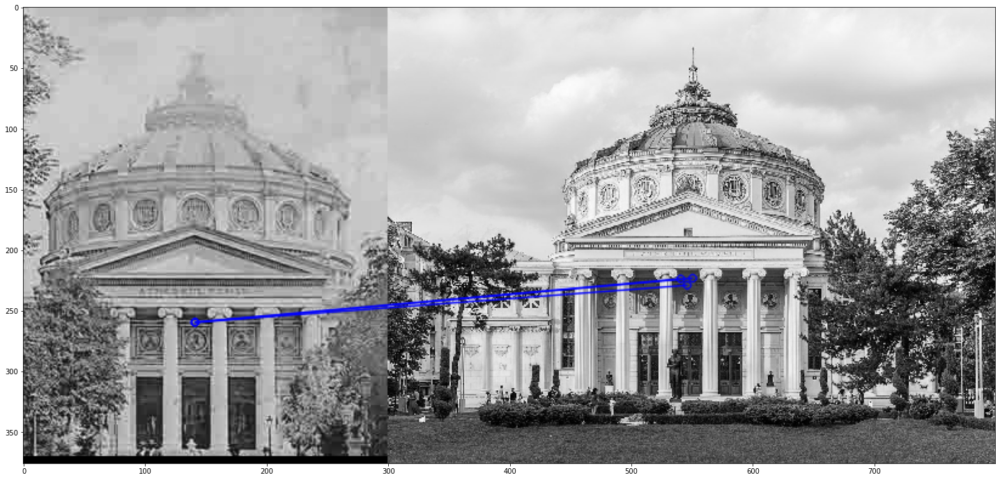

In [43]:
#here we explain only for the keypoint iith_kp_postcard
explain_matches(    img1_rgb_postcard = img1_cut_postcard,
                    img1_rgb_photo = read_and_prepare_image(img_filename = "candidate7.jpg"),
                    result_matches = knn_matches_postcard_photo7_KAZE,
                    keypoints_postcard = [el["keypoints"] for el in postcard_kpdescr_all_methods if el["method"] == method_][0], 
                    keypoints_photo = [el["keypoints"] for el in dict_kpdescr_photos["candidate7.jpg"] if el["method"] == method_][0],
                    iith_kp_postcard = iith_kp_postcard, k = 3
                )

Now we create a more customized method to investigate the results:

In [44]:
def explain_matches_extended(img1_rgb_postcard, img1_rgb_photo, result_matches,
                             keypoints_postcard, keypoints_photo, k = 1, iith_kp_postcard = None ):
    """here we draw lines for correspondences and plot the patches matched"""
    
    #convert to grayscale
    gray_postcard = cv2.cvtColor(img1_rgb_postcard, cv2.COLOR_BGR2GRAY)
    gray_photo = cv2.cvtColor(img1_rgb_photo, cv2.COLOR_BGR2GRAY)

    #config for patches
    dict_mrsize = {"ORB": 1.0, "SIFT": 6.0, "KAZE": 3.0, "SURF":1.0}
    mrSize = dict_mrsize["SIFT"]
    PATCH_SIZE = 50

    fig,ax = plt.subplots(1,2,figsize=(25,15))

    if iith_kp_postcard is not None:
        selected_matches = result_matches[iith_kp_postcard * k: iith_kp_postcard *k + k]
    else:
        selected_matches = result_matches

    #use axes divider to subdivide a subplot into 2 parts, the extra axis will contain smaller images (of matched patches)
    divider1 = make_axes_locatable(ax[0])
    ax0_extra = divider1.append_axes("bottom", size="20%", pad=0.5) 

    #for the right side photo, we add the extra axes later, in the for loop
    divider = make_axes_locatable(ax[1])

    #plot the correspondences lines and circles(for ther endpoints)
    ax[0].imshow(gray_postcard, cmap="gray")
    ax[1].imshow(gray_photo, cmap="gray", zorder= 0)

    #extract patch around the keypoint in postcard
    patch_in_postcard = extract_patches([keypoints_postcard[iith_kp_postcard]], img1_rgb_postcard, PATCH_SIZE, mrSize, 'cv2') 
    ax0_extra.imshow(patch_in_postcard[0])

    list_corresp = [result_matches[iith_kp_postcard*k+jj] for jj in range(k)]
    #red will be the match with smallest distance (1st best correspondence), orange will be 2nd best, yellow will be 3rd best
    colors = ["red", "orange", "yellow"]
    

    for ii,a_match in enumerate(list_corresp):
        assert(isinstance(a_match, cv2.DMatch))
        print(a_match.queryIdx, a_match.trainIdx, a_match.distance)
        keypoint_postcard_xy = keypoints_postcard[a_match.queryIdx].pt
        keypoint_photo_xy = keypoints_photo[a_match.trainIdx].pt
        s = "postcard keypoint {} (of radius {})  links to photo keypoint {} (of radius {}) "
        print(s.format(keypoint_postcard_xy, round(keypoints_postcard[a_match.queryIdx].size,3),
                       keypoint_photo_xy, round(keypoints_photo[a_match.trainIdx].size,3)))
        #draw a connection path between subplots of matplotlib
        con = ConnectionPatch(xyA=keypoint_postcard_xy,
                              xyB= keypoint_photo_xy,
                              coordsA="data", coordsB="data",
                              axesA=ax[0],
                              axesB=ax[1], 
                              color=colors[ii], linewidth=5)
        #con need to be added to the second subplot
        ax[1].add_artist(con)

        #extract patch around the keypoint in photo
        patch_in_photo = extract_patches([keypoints_photo[a_match.trainIdx]],
                                         img1_rgb_photo, PATCH_SIZE, mrSize, 'cv2') 
        
        ax1_extra = divider.append_axes("bottom", size="20%", pad=0.5)
        ax1_extra.imshow(patch_in_photo[0])



551 1578 0.2902607321739197
postcard keypoint (141.05560302734375, 259.3121337890625) (of radius 16.502)  links to photo keypoint (246.15447998046875, 228.80337524414062) (of radius 16.6) 
551 1419 0.397713840007782
postcard keypoint (141.05560302734375, 259.3121337890625) (of radius 16.502)  links to photo keypoint (250.6473388671875, 222.98654174804688) (of radius 9.821) 
551 1420 0.4177556335926056
postcard keypoint (141.05560302734375, 259.3121337890625) (of radius 16.502)  links to photo keypoint (240.7359161376953, 223.54568481445312) (of radius 9.817) 


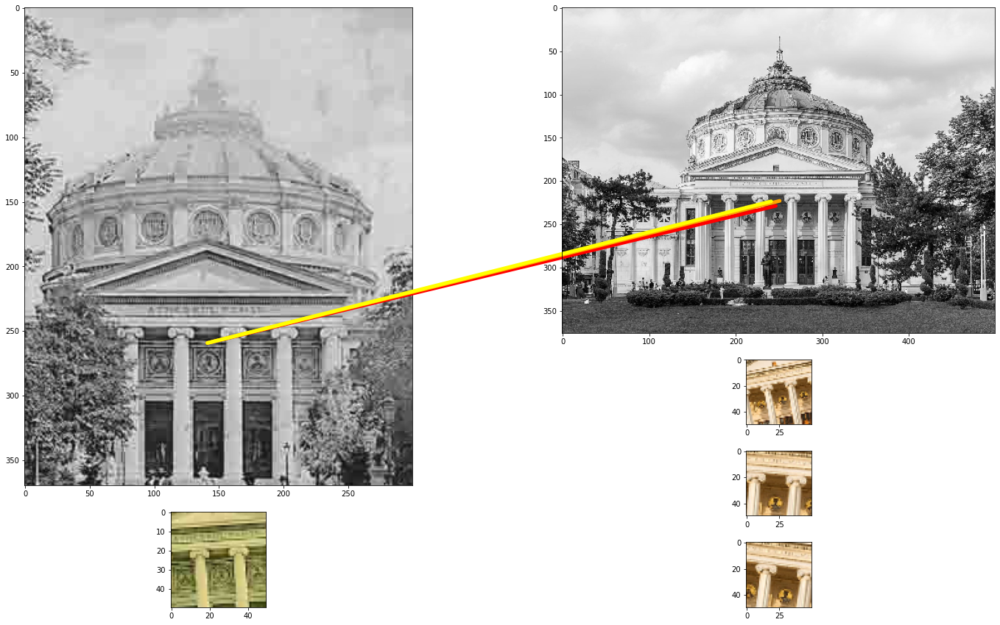

In [46]:
explain_matches_extended(    img1_rgb_postcard = img1_cut_postcard,
                    img1_rgb_photo = read_and_prepare_image(img_filename = "candidate7.jpg"),
                    result_matches = knn_matches_postcard_photo7_KAZE,
                    keypoints_postcard = [el["keypoints"] for el in postcard_kpdescr_all_methods if el["method"] == method_][0], 
                    keypoints_photo = [el["keypoints"] for el in dict_kpdescr_photos["candidate7.jpg"] if el["method"] == method_][0],
                    iith_kp_postcard = iith_kp_postcard, k = 3
                )

**ANOTHER ILLUSTRATION:**

518 1429 0.37396493554115295
postcard keypoint (200.0500030517578, 272.5882873535156) (of radius 12.322)  links to photo keypoint (193.23971557617188, 238.85841369628906) (of radius 9.672) 
518 1538 0.42834070324897766
postcard keypoint (200.0500030517578, 272.5882873535156) (of radius 12.322)  links to photo keypoint (236.7325439453125, 292.349853515625) (of radius 11.784) 
518 1532 0.42884209752082825
postcard keypoint (200.0500030517578, 272.5882873535156) (of radius 12.322)  links to photo keypoint (231.61196899414062, 280.1750183105469) (of radius 12.292) 


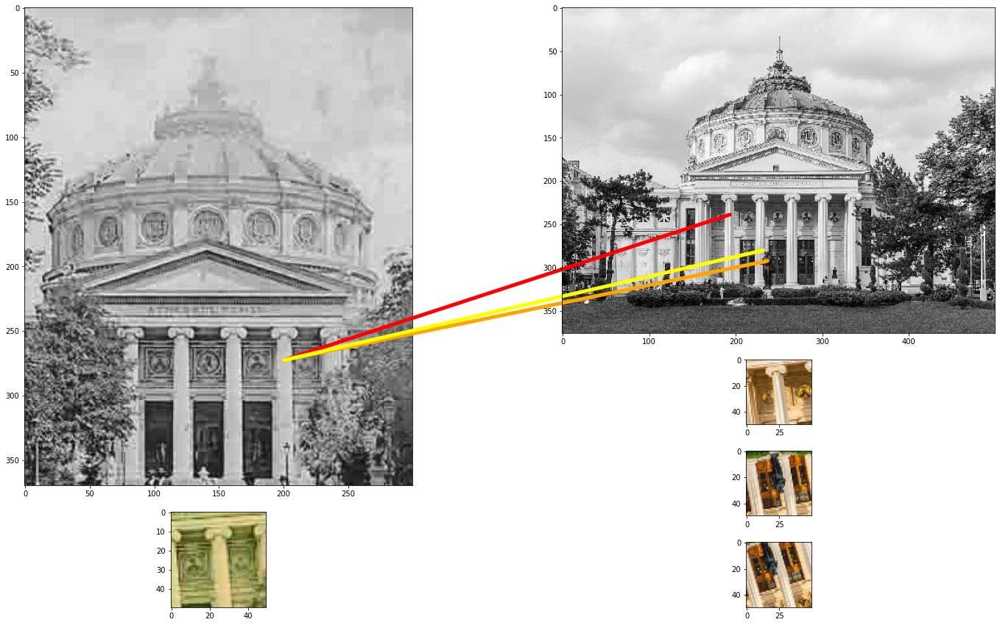

In [47]:
explain_matches_extended(    img1_rgb_postcard = img1_cut_postcard,
                    img1_rgb_photo = read_and_prepare_image(img_filename = "candidate7.jpg"),
                    result_matches = knn_matches_postcard_photo7_KAZE,
                    keypoints_postcard = [el["keypoints"] for el in postcard_kpdescr_all_methods if el["method"] == method_][0], 
                    keypoints_photo = [el["keypoints"] for el in dict_kpdescr_photos["candidate7.jpg"] if el["method"] == method_][0],
                    iith_kp_postcard = 518, k = 3
                )

**ANOTHER ILLUSTRATION:**

Here we see an architectural item (door corner) that gets correctly matched twice (red and orange) on 2 different doors.

330 1030 0.30765771865844727
postcard keypoint (96.46941375732422, 308.5282287597656) (of radius 5.836)  links to photo keypoint (274.7000732421875, 271.81719970703125) (of radius 5.799) 
330 451 0.3924524784088135
postcard keypoint (96.46941375732422, 308.5282287597656) (of radius 5.836)  links to photo keypoint (207.61044311523438, 269.96527099609375) (of radius 3.457) 
330 968 0.45883992314338684
postcard keypoint (96.46941375732422, 308.5282287597656) (of radius 5.836)  links to photo keypoint (218.3851318359375, 245.8690185546875) (of radius 5.796) 


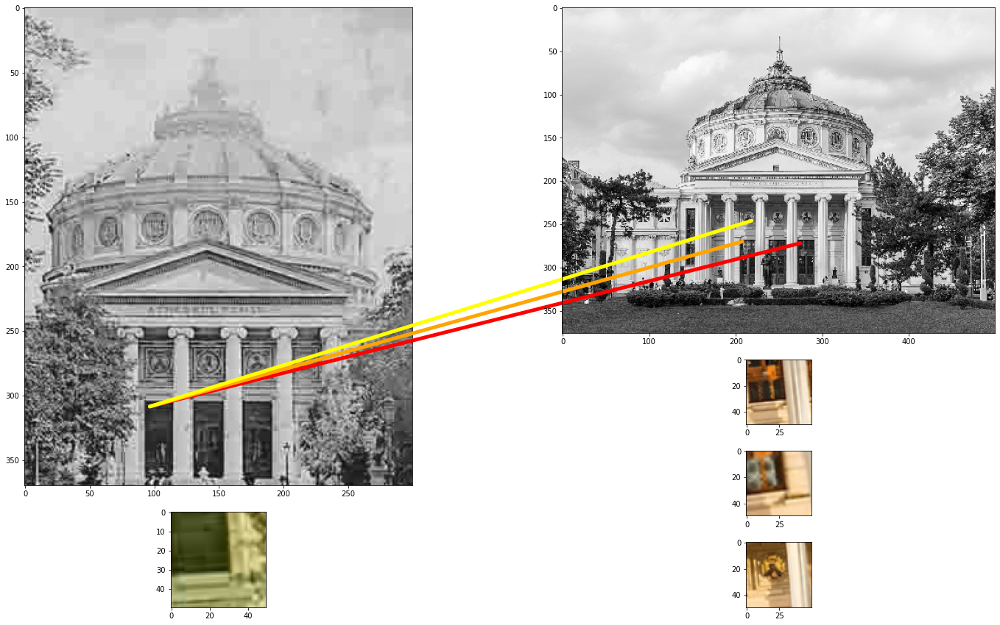

In [48]:
explain_matches_extended(    img1_rgb_postcard = img1_cut_postcard,
                    img1_rgb_photo = read_and_prepare_image(img_filename = "candidate7.jpg"),
                    result_matches = knn_matches_postcard_photo7_KAZE,
                    keypoints_postcard = [el["keypoints"] for el in postcard_kpdescr_all_methods if el["method"] == method_][0], 
                    keypoints_photo = [el["keypoints"] for el in dict_kpdescr_photos["candidate7.jpg"] if el["method"] == method_][0],
                    iith_kp_postcard = 330, k = 3
                )

**ANOTHER ILLUSTRATION:**

350 509 0.3103708326816559
postcard keypoint (186.42196655273438, 331.259765625) (of radius 5.827)  links to photo keypoint (208.8122100830078, 288.818115234375) (of radius 3.485) 
350 1067 0.3206358551979065
postcard keypoint (186.42196655273438, 331.259765625) (of radius 5.827)  links to photo keypoint (284.8482360839844, 289.9758605957031) (of radius 5.62) 
350 510 0.3398205637931824
postcard keypoint (186.42196655273438, 331.259765625) (of radius 5.827)  links to photo keypoint (286.2286682128906, 289.0990295410156) (of radius 3.492) 


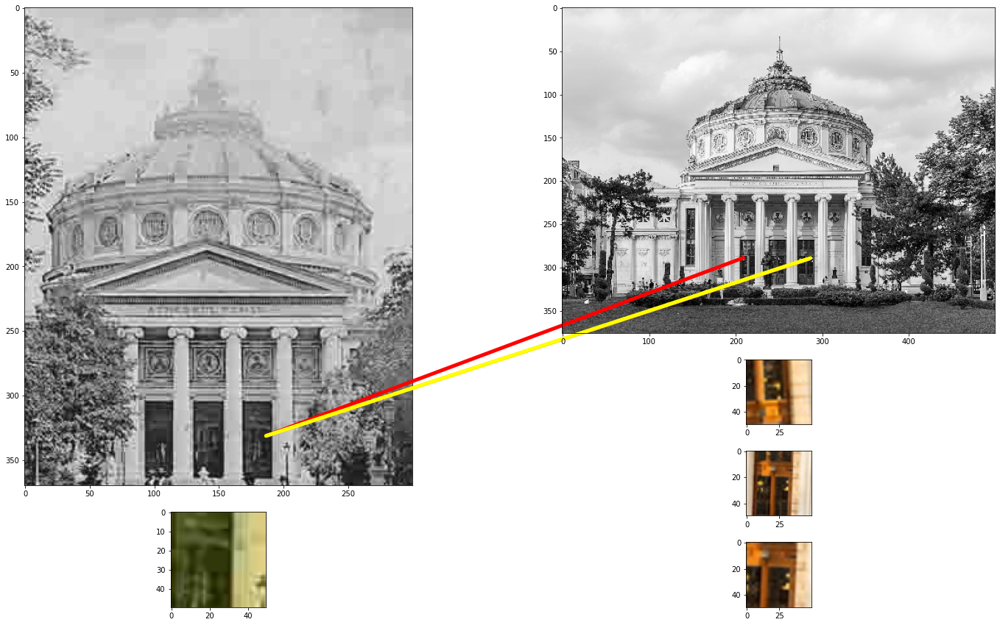

In [49]:
explain_matches_extended(    img1_rgb_postcard = img1_cut_postcard,
                    img1_rgb_photo = read_and_prepare_image(img_filename = "candidate7.jpg"),
                    result_matches = knn_matches_postcard_photo7_KAZE,
                    keypoints_postcard = [el["keypoints"] for el in postcard_kpdescr_all_methods if el["method"] == method_][0], 
                    keypoints_photo = [el["keypoints"] for el in dict_kpdescr_photos["candidate7.jpg"] if el["method"] == method_][0],
                    iith_kp_postcard = 350, k = 3
                )

**ANOTHER ILLUSTRATION:**

This time the best proposed correspondence (red) is not satisfactory.

125 1558 0.4090297818183899
postcard keypoint (222.06581115722656, 313.2613830566406) (of radius 3.479)  links to photo keypoint (320.0696716308594, 121.92554473876953) (of radius 16.222) 
125 923 0.4091229736804962
postcard keypoint (222.06581115722656, 313.2613830566406) (of radius 3.479)  links to photo keypoint (113.74528503417969, 228.17462158203125) (of radius 5.878) 
125 903 0.42705729603767395
postcard keypoint (222.06581115722656, 313.2613830566406) (of radius 3.479)  links to photo keypoint (105.39678955078125, 223.42947387695312) (of radius 5.862) 


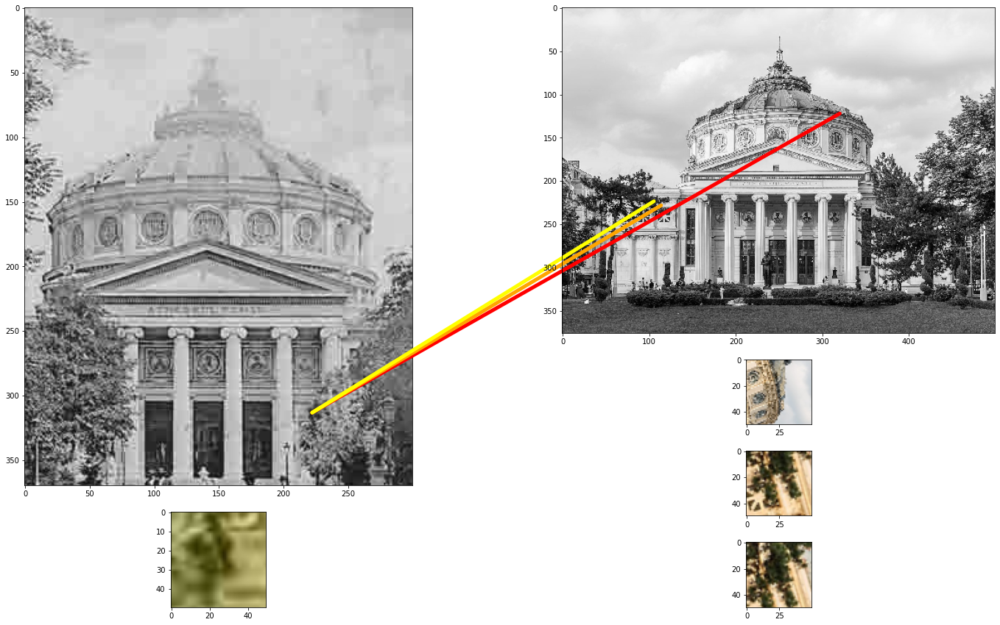

In [50]:
explain_matches_extended(    img1_rgb_postcard = img1_cut_postcard,
                    img1_rgb_photo = read_and_prepare_image(img_filename = "candidate7.jpg"),
                    result_matches = knn_matches_postcard_photo7_KAZE,
                    keypoints_postcard = [el["keypoints"] for el in postcard_kpdescr_all_methods if el["method"] == method_][0], 
                    keypoints_photo = [el["keypoints"] for el in dict_kpdescr_photos["candidate7.jpg"] if el["method"] == method_][0],
                    iith_kp_postcard = 125, k = 3
                )

## Inliners and outliers with Random Sample Consensus (RANSAC) 

Preamble:

"Random sample consensus, or RANSAC, is an iterative method for estimating a mathematical model from a data set that contains outliers. The RANSAC algorithm works by identifying the outliers in a data set and estimating the desired model using data that does not contain outliers."[9]

[9] https://uk.mathworks.com/discovery/ransac.html  
[10] https://apps.dtic.mil/dtic/tr/fulltext/u2/a460585.pdf

In OpenCV, RANSAC is used in the implementation of cv2.findHomography , yet we can get the actual inliners and outliers sets from it

In [51]:
help(cv2.findHomography)

Help on built-in function findHomography:

findHomography(...)
    findHomography(srcPoints, dstPoints[, method[, ransacReprojThreshold[, mask[, maxIters[, confidence]]]]]) -> retval, mask
    .   @brief Finds a perspective transformation between two planes.
    .   
    .   @param srcPoints Coordinates of the points in the original plane, a matrix of the type CV_32FC2
    .   or vector\<Point2f\> .
    .   @param dstPoints Coordinates of the points in the target plane, a matrix of the type CV_32FC2 or
    .   a vector\<Point2f\> .
    .   @param method Method used to compute a homography matrix. The following methods are possible:
    .   -   **0** - a regular method using all the points, i.e., the least squares method
    .   -   **RANSAC** - RANSAC-based robust method
    .   -   **LMEDS** - Least-Median robust method
    .   -   **RHO** - PROSAC-based robust method
    .   @param ransacReprojThreshold Maximum allowed reprojection error to treat a point pair as an inlier
    .   (us

In [52]:
#filter  knn_matches_postcard_photo7_KAZE  to have distance smaller than distance_thresh
distance_thresh = 0.35

knn_matches_postcard_photo7_KAZE_filtered = [el for el in knn_matches_postcard_photo7_KAZE
                                              if el.distance < distance_thresh ]

s = "the filtering based on distance_thresh = {} reduced the number of proposed correspondences from {} to {}"
print(s.format(distance_thresh, len(knn_matches_postcard_photo7_KAZE), len(knn_matches_postcard_photo7_KAZE_filtered)))

the filtering based on distance_thresh = 0.35 reduced the number of proposed correspondences from 1680 to 209


In [53]:
keypoints_postcard = [el["keypoints"] for el in postcard_kpdescr_all_methods if el["method"] == method_][0]
keypoints_photo = [el["keypoints"] for el in dict_kpdescr_photos["candidate7.jpg"] if el["method"] == method_][0]

keypoints_postcard_filtered = []
keypoints_photo_filtered = []

for a_match in knn_matches_postcard_photo7_KAZE_filtered:
    keypoints_postcard_filtered.append(keypoints_postcard[a_match.queryIdx])
    keypoints_photo_filtered.append(keypoints_photo[a_match.trainIdx])

In [54]:
H,m = cv2.findHomography(srcPoints = np.float32([kp.pt for kp in keypoints_postcard_filtered]).reshape(-1, 1, 2), 
                         dstPoints = np.float32([kp.pt for kp in keypoints_photo_filtered]).reshape(-1, 1, 2), 
                         method = cv2.RANSAC)

In [55]:
H

array([[ 1.03520713e+00,  1.82461187e-01,  9.53309357e+01],
       [-1.67249162e-02,  1.23976206e+00, -5.31879093e+01],
       [-1.31475208e-04,  7.35147963e-04,  1.00000000e+00]])

In [56]:
mask_inliners_vs_outliers = m.reshape(1,-1)
print(mask_inliners_vs_outliers.shape)
print("number of correspondences retained as inliners :", mask_inliners_vs_outliers.sum())
mask_inliners_vs_outliers

(1, 209)
number of correspondences retained as inliners : 38


array([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0,
        1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1,
        0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
        0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0,
        0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1,
        0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1]], dtype=uint8)

In [57]:
knn_matches_postcard_photo7_KAZE_inliners = [knn_matches_postcard_photo7_KAZE_filtered[i] 
                                              for i in range(len(knn_matches_postcard_photo7_KAZE_filtered))
                                              if mask_inliners_vs_outliers[0][i] == 1]


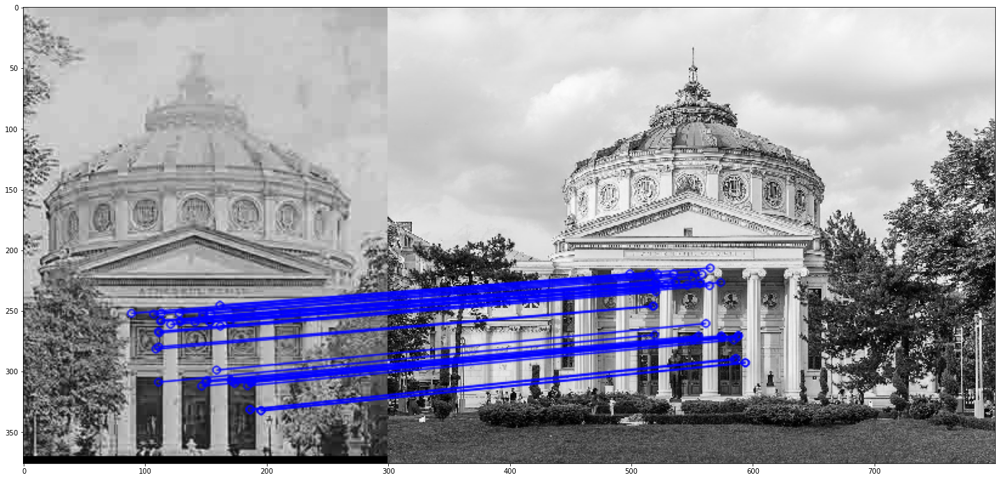

In [58]:
explain_matches(    img1_rgb_postcard = img1_cut_postcard,
                    img1_rgb_photo = read_and_prepare_image(img_filename = "candidate7.jpg"),
                    result_matches = knn_matches_postcard_photo7_KAZE_inliners,
                    keypoints_postcard = [el["keypoints"] for el in postcard_kpdescr_all_methods if el["method"] == method_][0], 
                    keypoints_photo = [el["keypoints"] for el in dict_kpdescr_photos["candidate7.jpg"] if el["method"] == method_][0]
                )

Great!

## End-to-end images similarity evaluation

In [60]:
dict_distance_thresh = {"SIFT": 250, "SURF": 0.25, "ORB": 55, "BRISK":90, 
                        "KAZE":0.35, "AKAZE": 85, "FREAK": 100, "BRIEF":50}

In [59]:
def end2end_images_similarity_eval(dict_result_local_descriptors_postcard, dict_result_local_descriptors_photo,
                                   k = 3, distance_thresh = 0.35):
    """ starting with a set of salient points & descriptors for the postcard,
        and with another set of salient points & descriptors for a candidate photo,
        use knn with specified to find for each keypoint of postcard k correspondencies among keypoints of photo,
        then filter these with a distance threshold and apply RANSAC to obtain only the inliners
    """
         
    
    #between the postcard and the good photo, using knn-based matching
    knn_matches_postcard_photo_METHOD = image_comparison(dict_result_local_descriptors_postcard, 
                                                         dict_result_local_descriptors_photo,
                                                         k = k, debug_flag = False)

    print("\n flattened array has length:", len(knn_matches_postcard_photo_METHOD))

    #filter list to have distance smaller than distance_thresh
    knn_matches_postcard_photo_METHOD_filtered = [el for el in knn_matches_postcard_photo_METHOD
                                                        if el.distance < distance_thresh ]

    s = "the filtering based on distance_thresh = {} reduced the number of proposed correspondences from {} to {}"
    print(s.format(distance_thresh, len(knn_matches_postcard_photo_METHOD), len(knn_matches_postcard_photo_METHOD_filtered)))

    keypoints_postcard = dict_result_local_descriptors_postcard["keypoints"] 
    keypoints_photo = dict_result_local_descriptors_photo["keypoints"] 

    keypoints_postcard_filtered = []
    keypoints_photo_filtered = []

    for a_match in knn_matches_postcard_photo_METHOD_filtered:
        keypoints_postcard_filtered.append(keypoints_postcard[a_match.queryIdx])
        keypoints_photo_filtered.append(keypoints_photo[a_match.trainIdx])  

    H,m = cv2.findHomography(srcPoints = np.float32([kp.pt for kp in keypoints_postcard_filtered]).reshape(-1, 1, 2), 
                             dstPoints = np.float32([kp.pt for kp in keypoints_photo_filtered]).reshape(-1, 1, 2), 
                             method = cv2.RANSAC)
    

    mask_inliners_vs_outliers = m.reshape(1,-1)
    print("number of correspondences retained as inliners :", mask_inliners_vs_outliers.sum())
    
    knn_matches_postcard_photo_METHOD_inliners = [knn_matches_postcard_photo_METHOD_filtered[i] 
                                                      for i in range(len(knn_matches_postcard_photo_METHOD_filtered))
                                                         if mask_inliners_vs_outliers[0][i] == 1]


    return knn_matches_postcard_photo_METHOD_inliners


In [76]:
def caller_end2end(the_method = "KAZE", the_photo_filename = "candidate7.jpg", k = 3, vis_flag=True):
    """ helper function to prepare inputs and optionally visualize inliner corespondencies"""

    knn_matches_postcard_photox_METHOD_inliners = end2end_images_similarity_eval(
        dict_result_local_descriptors_postcard = [el for el in postcard_kpdescr_all_methods if el["method"] == the_method][0], 
        dict_result_local_descriptors_photo = [el for el in dict_kpdescr_photos[the_photo_filename] if el["method"] == the_method][0],
        k = 3, 
        distance_thresh = dict_distance_thresh[the_method])
    
    if vis_flag is True:
        explain_matches(  img1_rgb_postcard = img1_cut_postcard,
                          img1_rgb_photo = read_and_prepare_image(img_filename = the_photo_filename),
                    result_matches = knn_matches_postcard_photox_METHOD_inliners,
                    keypoints_postcard = [el["keypoints"] for el in postcard_kpdescr_all_methods if el["method"] == the_method][0], 
                    keypoints_photo = [el["keypoints"] for el in dict_kpdescr_photos[the_photo_filename] if el["method"] == the_method][0]
                )
    
    return knn_matches_postcard_photox_METHOD_inliners

### On photo candidate7.jpg

Studying the same pair of images (postcard and candidate7.jpg), now we use other methods instead of KAZE:

**SIFT:**


 flattened array has length: 3426
the filtering based on distance_thresh = 250 reduced the number of proposed correspondences from 3426 to 266
number of correspondences retained as inliners : 17


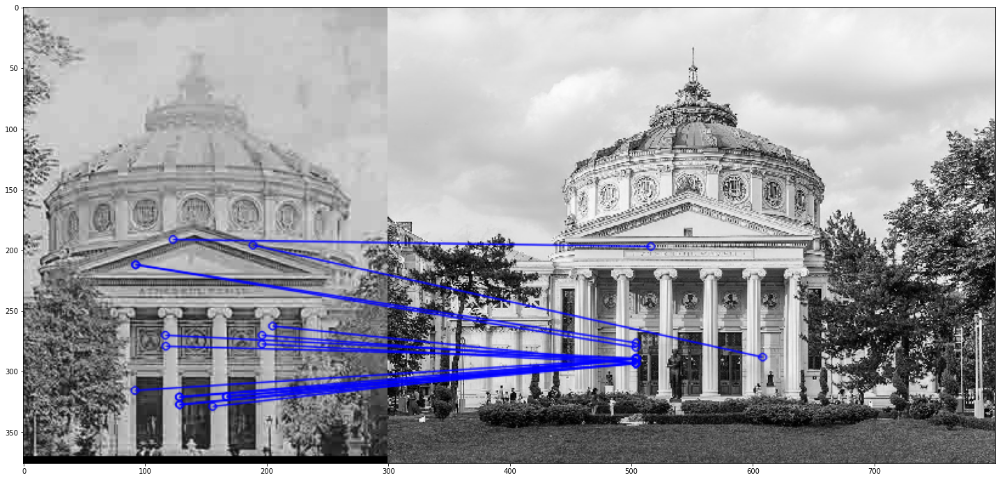

In [77]:
knn_matches_postcard_photo7_SIFT_inliners = caller_end2end(the_method = "SIFT", the_photo_filename = "candidate7.jpg", k = 3, vis_flag=True)

**SURF:**


 flattened array has length: 2511
the filtering based on distance_thresh = 0.25 reduced the number of proposed correspondences from 2511 to 530
number of correspondences retained as inliners : 21


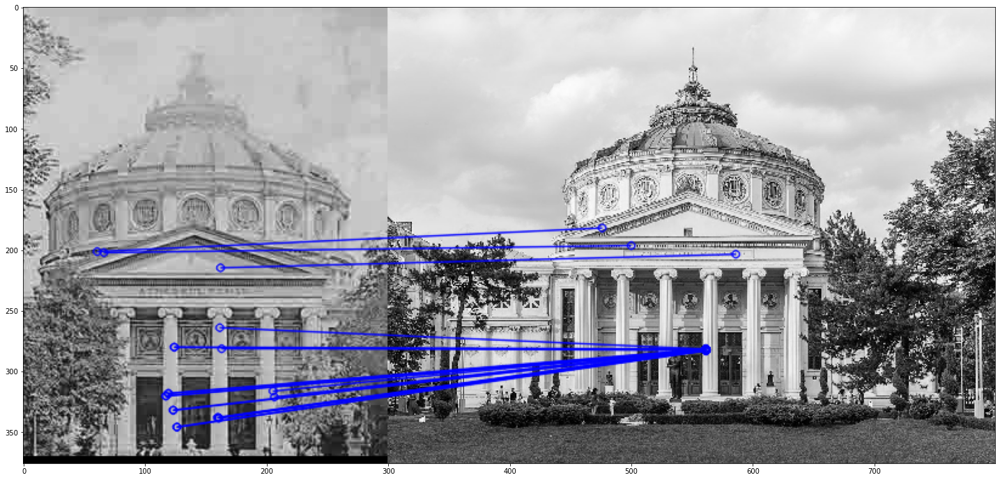

In [78]:
knn_matches_postcard_photo7_SURF_inliners = caller_end2end(the_method = "SURF", the_photo_filename = "candidate7.jpg", k = 3, vis_flag=True)

**BRISK:**


 flattened array has length: 6300
the filtering based on distance_thresh = 90 reduced the number of proposed correspondences from 6300 to 101
number of correspondences retained as inliners : 13


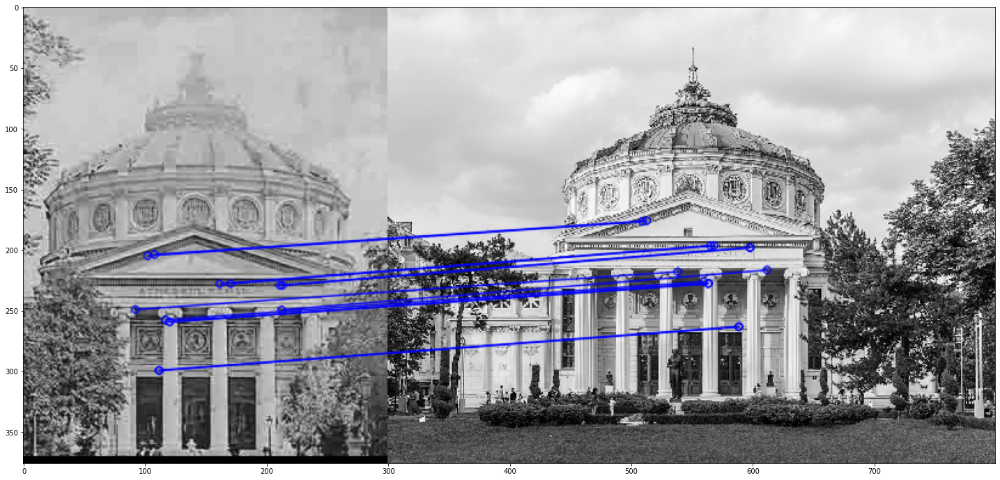

In [79]:
knn_matches_postcard_photo7_BRISK_inliners = caller_end2end(the_method = "BRISK", the_photo_filename = "candidate7.jpg", k = 3, vis_flag=True)

**FREAK:**


 flattened array has length: 1140
the filtering based on distance_thresh = 100 reduced the number of proposed correspondences from 1140 to 182
number of correspondences retained as inliners : 14


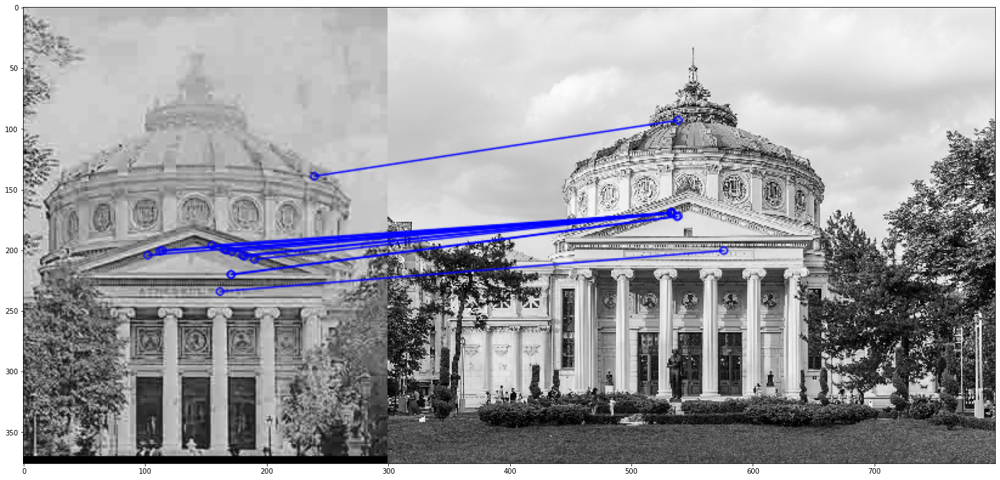

In [80]:
knn_matches_postcard_photo7_FREAK_inliners = caller_end2end(the_method = "FREAK", the_photo_filename = "candidate7.jpg", k = 3, vis_flag=True)

**BRIEF:**


 flattened array has length: 207
the filtering based on distance_thresh = 50 reduced the number of proposed correspondences from 207 to 132
number of correspondences retained as inliners : 19


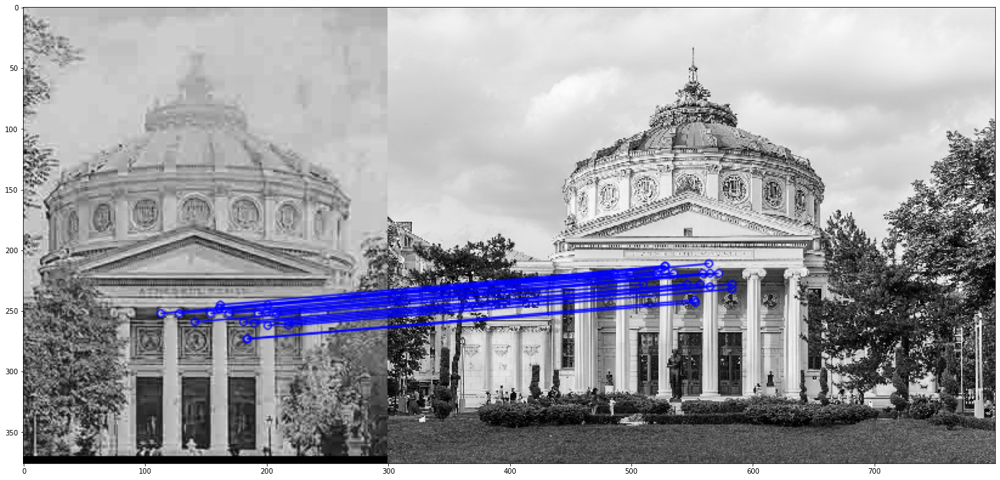

In [81]:
knn_matches_postcard_photo7_BRIEF_inliners = caller_end2end(the_method = "BRIEF", the_photo_filename = "candidate7.jpg", k = 3, vis_flag=True)

------------

### On photo candidate5.jpg

Now illustrate with photo candidate5.jpg

**KAZE:**


 flattened array has length: 1680
the filtering based on distance_thresh = 0.35 reduced the number of proposed correspondences from 1680 to 95
number of correspondences retained as inliners : 7


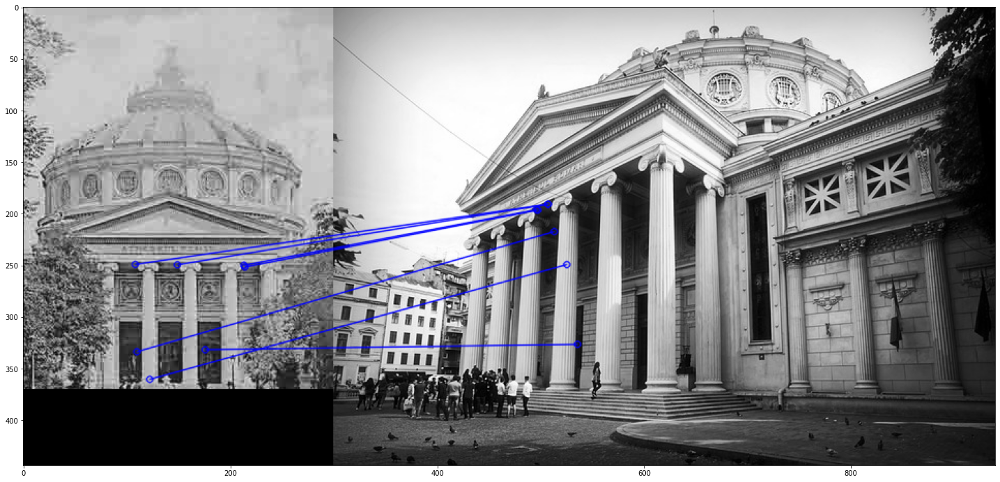

In [83]:
knn_matches_postcard_photo5_KAZE_inliners = caller_end2end(the_method = "KAZE", the_photo_filename = "candidate5.jpg", k = 3, vis_flag=True)

**BRIEF:**


 flattened array has length: 207
the filtering based on distance_thresh = 50 reduced the number of proposed correspondences from 207 to 40
number of correspondences retained as inliners : 7


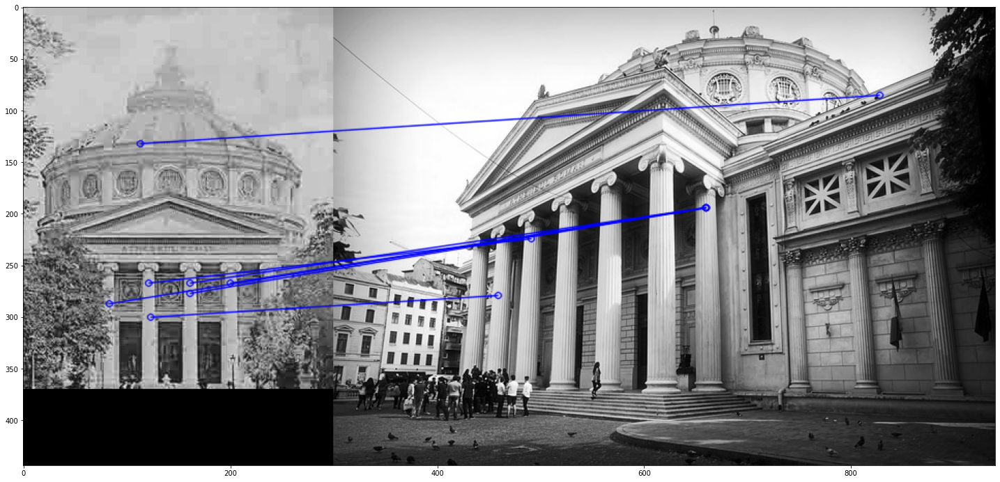

In [84]:
knn_matches_postcard_photo7_BRIEF_inliners = caller_end2end(the_method = "BRIEF", the_photo_filename = "candidate5.jpg", k = 3, vis_flag=True)

------------

### On photo candidate8.jpg

Now illustrate with photo candidate8.jpg

**KAZE:**


 flattened array has length: 1680
the filtering based on distance_thresh = 0.35 reduced the number of proposed correspondences from 1680 to 17
number of correspondences retained as inliners : 6


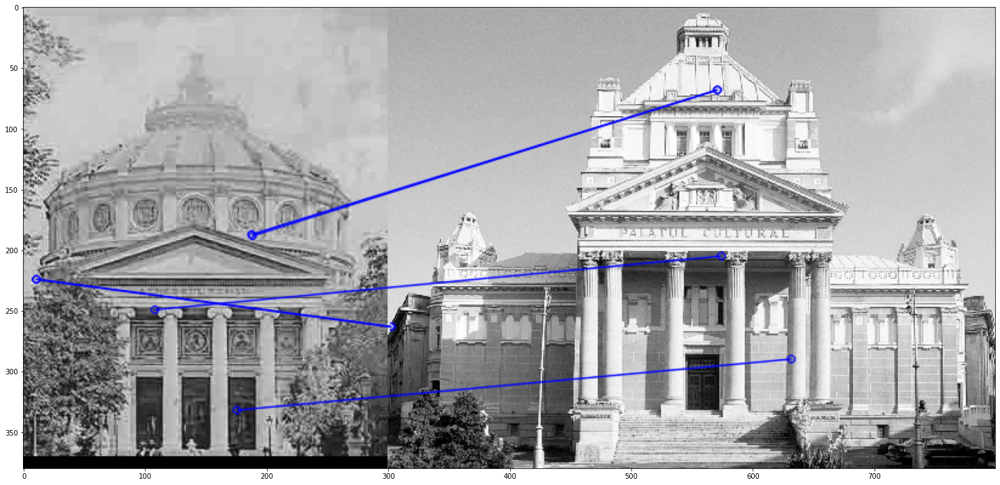

In [85]:
knn_matches_postcard_photo8_KAZE_inliners = caller_end2end(the_method = "KAZE", the_photo_filename = "candidate8.jpg", k = 3, vis_flag=True)

**BRIEF:**


 flattened array has length: 207
the filtering based on distance_thresh = 50 reduced the number of proposed correspondences from 207 to 57
number of correspondences retained as inliners : 10


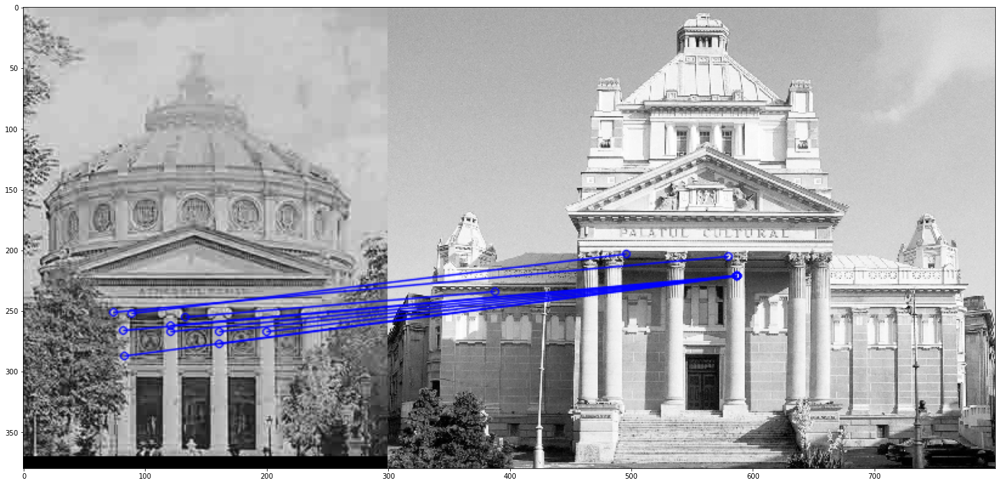

In [86]:
knn_matches_postcard_photo8_BRIEF_inliners = caller_end2end(the_method = "BRIEF", the_photo_filename = "candidate8.jpg", k = 3, vis_flag=True)

------------

### On photo candidate2.jpg

Now illustrate with photo candidate2.jpg

**KAZE:**


 flattened array has length: 1680
the filtering based on distance_thresh = 0.35 reduced the number of proposed correspondences from 1680 to 56
number of correspondences retained as inliners : 8


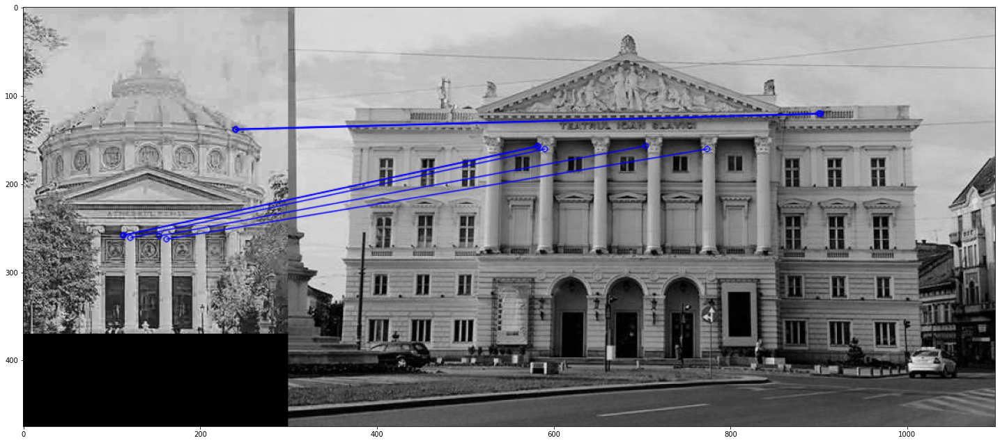

In [87]:
knn_matches_postcard_photo2_KAZE_inliners = caller_end2end(the_method = "KAZE", the_photo_filename = "candidate2.jpg", k = 3, vis_flag=True)

**BRIEF:**


 flattened array has length: 207
the filtering based on distance_thresh = 50 reduced the number of proposed correspondences from 207 to 126
number of correspondences retained as inliners : 8


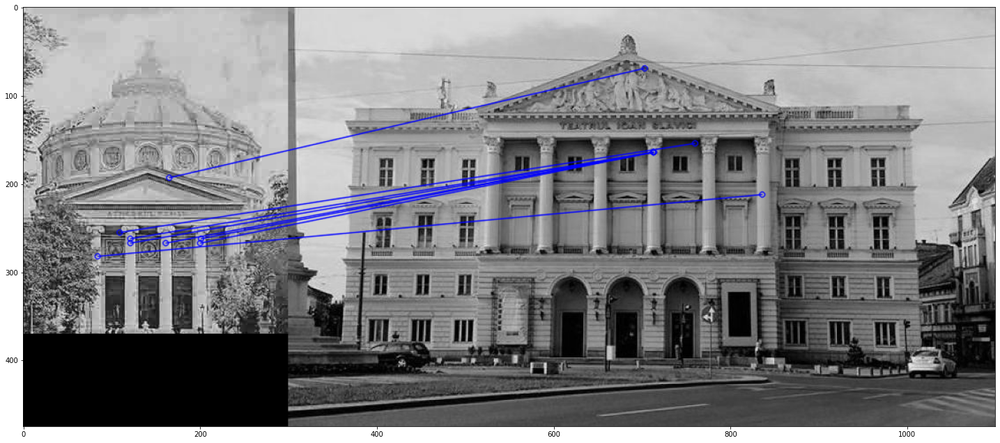

In [88]:
knn_matches_postcard_photo2_BRIEF_inliners = caller_end2end(the_method = "BRIEF", the_photo_filename = "candidate2.jpg", k = 3, vis_flag=True)

---------------------

### Summary

If we execute the end-to-end processing for the same method (KAZE) on all photos we get:

In [89]:
for the_photo_filename in dict_kpdescr_photos.keys():
    print("*** ", the_photo_filename)
    knn_matches_postcard_photox_KAZE_inliners = caller_end2end(the_method = "KAZE", 
                                                               the_photo_filename = the_photo_filename, 
                                                               k = 3, vis_flag=False)
    print("-----------------------------------------------")

***  candidate2.jpg

 flattened array has length: 1680
the filtering based on distance_thresh = 0.35 reduced the number of proposed correspondences from 1680 to 56
number of correspondences retained as inliners : 8
-----------------------------------------------
***  candidate3.jpg

 flattened array has length: 1680
the filtering based on distance_thresh = 0.35 reduced the number of proposed correspondences from 1680 to 27
number of correspondences retained as inliners : 7
-----------------------------------------------
***  candidate1.jpg

 flattened array has length: 1680
the filtering based on distance_thresh = 0.35 reduced the number of proposed correspondences from 1680 to 54
number of correspondences retained as inliners : 9
-----------------------------------------------
***  candidate4.jpg

 flattened array has length: 1680
the filtering based on distance_thresh = 0.35 reduced the number of proposed correspondences from 1680 to 41
number of correspondences retained as inliners 

The best match is candidate7.jpg, with 38 inliners, surpassing all other candidate-photos.   
Note also that candidate5.jpg (with rotated view of same building as in postcard) has 2nd largest number of correspondences after filter on distance threshold (value 95), yet many of these are discarded by RANSAC as not being inliners 

If we execute the end-to-end processing for the same method (BRIEF) on all photos we get:

In [91]:
for the_photo_filename in dict_kpdescr_photos.keys():
    print("*** ", the_photo_filename)
    knn_matches_postcard_photox_BRIEF_inliners = caller_end2end(the_method = "BRIEF", 
                                                               the_photo_filename = the_photo_filename, 
                                                               k = 3, vis_flag=False)
    print("-----------------------------------------------")

***  candidate2.jpg

 flattened array has length: 207
the filtering based on distance_thresh = 50 reduced the number of proposed correspondences from 207 to 126
number of correspondences retained as inliners : 8
-----------------------------------------------
***  candidate3.jpg

 flattened array has length: 207
the filtering based on distance_thresh = 50 reduced the number of proposed correspondences from 207 to 87
number of correspondences retained as inliners : 10
-----------------------------------------------
***  candidate1.jpg

 flattened array has length: 207
the filtering based on distance_thresh = 50 reduced the number of proposed correspondences from 207 to 59
number of correspondences retained as inliners : 11
-----------------------------------------------
***  candidate4.jpg

 flattened array has length: 207
the filtering based on distance_thresh = 50 reduced the number of proposed correspondences from 207 to 97
number of correspondences retained as inliners : 9
---------

With BRIEF, candidate7 is again on top, but candidate5 is far beyond.  
Note: for a different distance_thresh the situation might change.

If we execute the end-to-end processing for the same method (BRISK) on all photos we get:

In [90]:
for the_photo_filename in dict_kpdescr_photos.keys():
    print("*** ", the_photo_filename)
    knn_matches_postcard_photox_BRISK_inliners = caller_end2end(the_method = "BRISK", 
                                                               the_photo_filename = the_photo_filename, 
                                                               k = 3, vis_flag=False)
    print("-----------------------------------------------")

***  candidate2.jpg

 flattened array has length: 6300
the filtering based on distance_thresh = 90 reduced the number of proposed correspondences from 6300 to 32
number of correspondences retained as inliners : 8
-----------------------------------------------
***  candidate3.jpg

 flattened array has length: 6300
the filtering based on distance_thresh = 90 reduced the number of proposed correspondences from 6300 to 17
number of correspondences retained as inliners : 6
-----------------------------------------------
***  candidate1.jpg

 flattened array has length: 6300
the filtering based on distance_thresh = 90 reduced the number of proposed correspondences from 6300 to 15
number of correspondences retained as inliners : 5
-----------------------------------------------
***  candidate4.jpg

 flattened array has length: 6300
the filtering based on distance_thresh = 90 reduced the number of proposed correspondences from 6300 to 21
number of correspondences retained as inliners : 6
----

This time, both correct answers had larger numbers of inliners than the wrong answers.